# Abstract
       This is a final project for the CS539(Machine Learning) class offered in fall of 2022 at Worcester Polytechnic Institute. Dataset for house prices in London was chosen and different ML algorithms applied in order to find the best one for predicting the price of unknown house in London  based on different variables(features). Mean Absolute Error(MAE) and Mean Absolute Percentage Error(MAPE) were used for evaluating the performance of the model. The technique that performed the best is XGBOOST with MEPA of 17% and MAE of $238860.


# Overview and Motivation

    	Goal of this project is to create a Machine Learning model that can predict housing prices in London,UK. My plan is to find out the degree of correspondence between Location/Postal Code and the price of the house.Obviously, size plays a big role in price estimation but I want to know how big of a factor is its location. It is interesting to figure out which feature combinations give us the best price estimate. I think all of the variables in this dataset should play a significant role maybe except the "No. of Receptions" but I think the  main ones are "Location/Postal Code","Area in sq ft", and the "House Type".
 	The main reason I chose this project is that, In Georgia, the country I am from, there is no automated way of estimating house prices. A person needs to go and check every house manually. So I want to simplify this process and maybe create an app(depends on performance I get) where a user would put in all the different variables and get the price. A friend of mine works in one of the banks in Georgia an he has been talking about this problem for quite some time already so I thought it would be a fun project to work on. Plus he can provide me a bigger dataset if model performs well on this one.





# Related Work
       While trying to gather various materials that would help me, I stumbled upon an article on"towardsthedatascience.com". It is called "Predicting House Prices with Machine Learning”. Here is the link: https://towardsdatascience.com/predicting-house-prices-with-machine-learning-62d5bcd0d68f. The main goal of that project was similar to mine so it helped me to get started and  showed me the outline and general structure that my own project should have.
	In addition to that article, I found this paper to be an interesting read as well : https://www.hindawi.com/journals/sp/2021/7678931/.

# Initial Questions

     The question I want to answer is "Can we predict with 80% accuracy the price of the house 
     in London depending on House size, Location. Number of bedrooms ,Total Number of Rooms, House 
     Type and/or Postal Code".
     Machine learning question it answers is : How Much?( what is the price?).
     After several iterations of this project, the question remained the same, but method answering
     the question changed a bit.


# Data and EDA


#### Dataset
    The dataset I will be using is called "Housing Prices in London" which I found on Kaggle.
    Here is the link:https://www.kaggle.com/datasets/arnavkulkarni/housing-prices-in-london.
    

In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import warnings
from autoviz import AutoViz_Class as AV
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
%matplotlib inline

#ignore warnings
warnings.filterwarnings('ignore')

#load dataset 
df = pd.read_csv('London.csv',index_col=0)
display(df.head())
print("Shape of data:",df.shape)

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine


,Property Name,Price,House Type,Area in sq ft,No. of Bedrooms,No. of Bathrooms,No. of Receptions,Location,City/County,Postal Code
0,Queens Road,1675000,House,2716,5,5,5,Wimbledon,London,SW19 8NY
1,Seward Street,650000,Flat / Apartment,814,2,2,2,Clerkenwell,London,EC1V 3PA
2,Hotham Road,735000,Flat / Apartment,761,2,2,2,Putney,London,SW15 1QL
3,Festing Road,1765000,House,1986,4,4,4,Putney,London,SW15 1LP
4,Spencer Walk,675000,Flat / Apartment,700,2,2,2,Putney,London,SW15 1PL


Shape of data: (3480, 10)


       I have 3480 data samples and I plan to use all of it if there are no issues with samples.
       We have 10 features:"PropertyName","Price","House Type", "Area in sq ft", "No. of Bedrooms", 
       "No. of Bathrooms, "No. of Receptions", "Location","City/"County", "Postal Code". I encountred 
       no issues with getting and importing the data.


### Data Cleaning

     The first thing I notice is that the # of Bedrooms, Bathrooms, and Receptions are equal for all the houses 
     which I think is odd. Let's change their values randomly to either 1 or 2 to make dataset more diverse. 
     A House can have more bathrooms especially if it is a big one, but randomly generating numbers would 
     not work in this case because we can get a house with 2 bedrooms and 3 or more bathrooms 
     which does not make any sense so lets just stick to maximum of two bathrooms per house.
     Same reasoning goes behind changing "No.of Receptions values."


In [2]:
import random

#randomly generate number of bathrooms and receptions
df['No. of Bathrooms'] = df['No. of Bathrooms'].apply(lambda x:random.randrange(1, 3, 1))
df['No. of Receptions'] = df['No. of Receptions'].apply(lambda x:random.randrange(1, 3, 1))
df

,Property Name,Price,House Type,Area in sq ft,No. of Bedrooms,No. of Bathrooms,No. of Receptions,Location,City/County,Postal Code
0,Queens Road,1675000,House,2716,5,1,2,Wimbledon,London,SW19 8NY
1,Seward Street,650000,Flat / Apartment,814,2,1,1,Clerkenwell,London,EC1V 3PA
2,Hotham Road,735000,Flat / Apartment,761,2,2,1,Putney,London,SW15 1QL
3,Festing Road,1765000,House,1986,4,1,2,Putney,London,SW15 1LP
4,Spencer Walk,675000,Flat / Apartment,700,2,1,2,Putney,London,SW15 1PL
...,...,...,...,...,...,...,...,...,...,...
3475,One Lillie Square,3350000,New development,1410,3,1,2,NaN,Lillie Square,SW6 1UE
3476,St. James's Street,5275000,Flat / Apartment,1749,3,1,2,St James's,London,SW1A 1JT
3477,Ingram Avenue,5995000,House,4435,6,1,1,Hampstead Garden Suburb,London,NW11 6TG
3478,Cork Street,6300000,New development,1506,3,1,1,Mayfair,London,W1S 3AR


    There are 962 null values in "Location" column that means I can not use those so lets just get rid of them.

In [3]:
#check for null values
df.isnull().sum() 

Property Name          0
Price                  0
House Type             0
Area in sq ft          0
No. of Bedrooms        0
No. of Bathrooms       0
No. of Receptions      0
Location             962
City/County            0
Postal Code            0
dtype: int64

In [4]:
df.dropna(inplace=True) #drop null values
df.isnull().sum() # no more null values 

Property Name        0
Price                0
House Type           0
Area in sq ft        0
No. of Bedrooms      0
No. of Bathrooms     0
No. of Receptions    0
Location             0
City/County          0
Postal Code          0
dtype: int64

     So we are left with 2518 data samples.

In [5]:
df

,Property Name,Price,House Type,Area in sq ft,No. of Bedrooms,No. of Bathrooms,No. of Receptions,Location,City/County,Postal Code
0,Queens Road,1675000,House,2716,5,1,2,Wimbledon,London,SW19 8NY
1,Seward Street,650000,Flat / Apartment,814,2,1,1,Clerkenwell,London,EC1V 3PA
2,Hotham Road,735000,Flat / Apartment,761,2,2,1,Putney,London,SW15 1QL
3,Festing Road,1765000,House,1986,4,1,2,Putney,London,SW15 1LP
4,Spencer Walk,675000,Flat / Apartment,700,2,1,2,Putney,London,SW15 1PL
...,...,...,...,...,...,...,...,...,...,...
3473,Park Lane,19950000,Flat / Apartment,3698,5,2,1,Mayfair,London,W1K 7AJ
3476,St. James's Street,5275000,Flat / Apartment,1749,3,1,2,St James's,London,SW1A 1JT
3477,Ingram Avenue,5995000,House,4435,6,1,1,Hampstead Garden Suburb,London,NW11 6TG
3478,Cork Street,6300000,New development,1506,3,1,1,Mayfair,London,W1S 3AR


### Oultliers
    Lets search for outliers

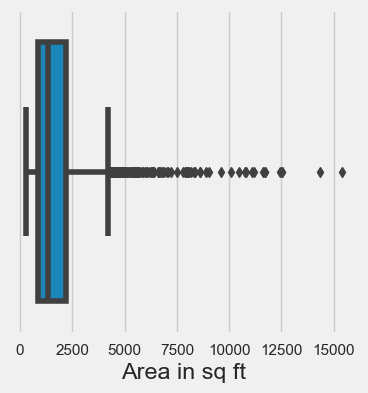

In [6]:
import seaborn as sns
pd.set_option('display.float_format', lambda x: '%.f' % x)
sns.boxplot(x=df["Area in sq ft"])
plt.gcf().set_size_inches((4, 4))    

plt.show()

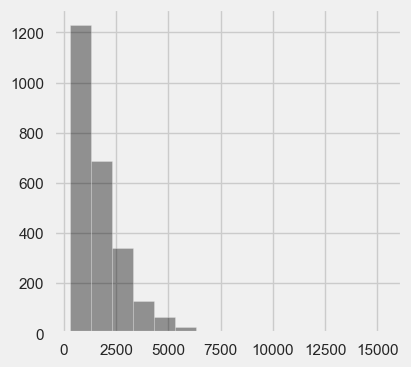

In [7]:
sns.distplot(x=df["Area in sq ft"],bins=15, kde=False,color="black")
plt.gcf().set_size_inches((4, 4))    
plt.show()

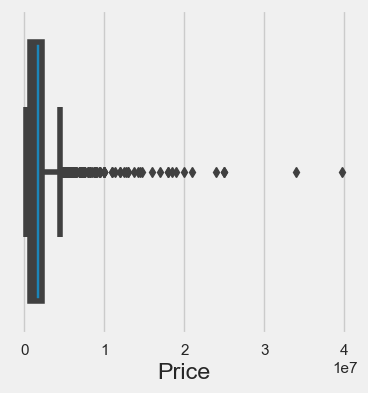

In [8]:
import seaborn as sns
pd.set_option('display.float_format', lambda x: '%.f' % x)
df['Price'].describe()
sns.boxplot(x=df["Price"])
plt.gcf().set_size_inches((4, 4))    

plt.show()

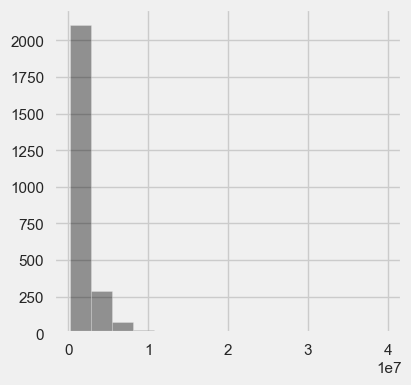

In [9]:
sns.distplot(x=df["Price"],bins=15, kde=False,color="black")
plt.gcf().set_size_inches((4, 4))    
plt.show()

### 
    Lets get rid of outliers we found

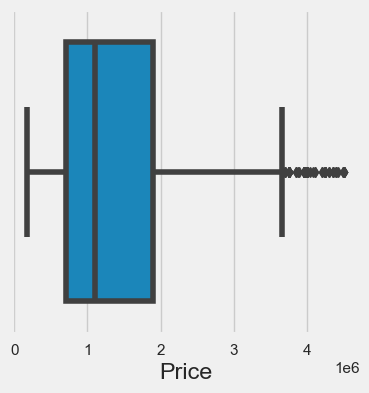

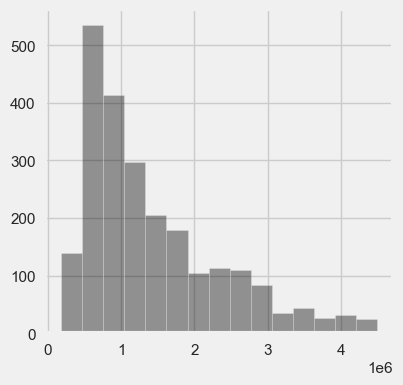

In [10]:
# Get interquintile range to remove outliers
Q1 = df["Price"].quantile(0.25)
Q3 = df["Price"].quantile(0.75)
IQR = Q3 - Q1

lower_lim = Q1 - 1.5 * IQR
upper_lim = Q3 + 1.5 * IQR 

outliers_low = (df["Price"] < lower_lim )
outliers_high =(df["Price"] > upper_lim )

#We lose 175 values if we remove outliers 

df["Price"][outliers_low | outliers_high]
df = df[~(outliers_low | outliers_high)]
sns.boxplot(x=df["Price"])
plt.gcf().set_size_inches((4, 4))    
plt.show()

sns.distplot(x=df["Price"],bins=15, kde=False,color="black")
plt.gcf().set_size_inches((4, 4))    
plt.show()

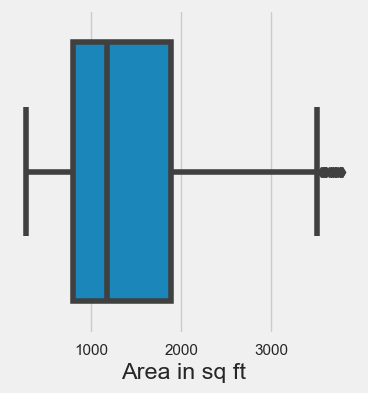

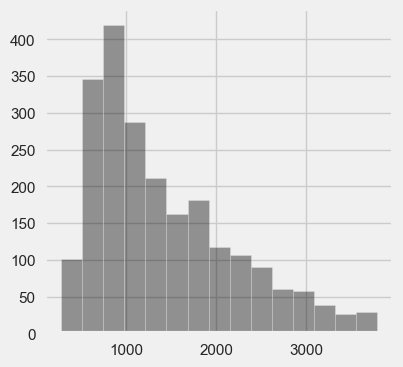

In [11]:
# Get interquintile range to remove outliers
Q1 = df["Area in sq ft"].quantile(0.25)
Q3 = df["Area in sq ft"].quantile(0.75)
IQR = Q3 - Q1

lower_lim = Q1 - 1.5 * IQR
upper_lim = Q3 + 1.5 * IQR 

outliers_low = (df["Area in sq ft"] < lower_lim )
outliers_high =(df["Area in sq ft"] > upper_lim )
#We lose 175 values if we remove outliers 

df["Area in sq ft"][outliers_low | outliers_high]
df = df[~(outliers_low | outliers_high)]
sns.boxplot(x=df["Area in sq ft"])
plt.gcf().set_size_inches((4, 4))    
plt.show()

sns.distplot(x=df["Area in sq ft"],bins=15, kde=False,color="black")
plt.gcf().set_size_inches((4, 4))    
plt.show()

## Basic Data Characteristics
    Let's explore our dataset more 

In [12]:
df.describe() # print summary of the data 

,Price,Area in sq ft,No. of Bedrooms,No. of Bathrooms,No. of Receptions
count,2235,2235,2235,2235,2235
mean,1340470,1409,3,2,2
std,858570,780,1,0,1
min,180000,274,0,1,1
25%,699950,800,2,1,1
50%,1075000,1177,3,2,2
75%,1750000,1882,4,2,2
max,4500000,3788,7,2,2


In [13]:
df.info() 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2235 entries, 0 to 3472
Data columns (total 10 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Property Name      2235 non-null   object
 1   Price              2235 non-null   int64 
 2   House Type         2235 non-null   object
 3   Area in sq ft      2235 non-null   int64 
 4   No. of Bedrooms    2235 non-null   int64 
 5   No. of Bathrooms   2235 non-null   int64 
 6   No. of Receptions  2235 non-null   int64 
 7   Location           2235 non-null   object
 8   City/County        2235 non-null   object
 9   Postal Code        2235 non-null   object
dtypes: int64(5), object(5)
memory usage: 192.1+ KB


In [14]:
df["Property Name"].value_counts() # explore categories of Propery Name

Television Centre    17
Bishops Gate         13
City Road            11
Junction House        8
Boat Race House       7
                     ..
Edenvale Street       1
Sandilands Road       1
Wollaton House        1
Larpent Avenue        1
Chelsea Crescent      1
Name: Property Name, Length: 1664, dtype: int64

In [15]:
df["Location"].value_counts() # explore categories of Location

Putney               92
Wandsworth           65
Barnes               64
Chiswick             56
Wimbledon            55
                     ..
 Dalston              1
162 Gideon Road       1
 Brentford            1
Bushey                1
 Waterfront Drive     1
Name: Location, Length: 616, dtype: int64

In [16]:
df["City/County"].value_counts() # explore categories of City/County

London                1869
Surrey                 194
Middlesex               66
Essex                   55
Hertfordshire            7
N7 6QX                   7
Fulham                   5
Chelsea                  3
Twickenham               3
Wandsworth               2
E5 8DE                   2
Watford                  2
Hornchurch               1
Queens Park              1
N1 6FU                   1
Kensington               1
Bushey                   1
Greenford                1
London1500               1
Marylebone               1
Little Venice            1
Fitzrovia                1
27 Carlton Drive         1
Fulham High Street       1
Chessington              1
City Of London           1
Richmond                 1
Deptford                 1
Clerkenwell              1
Downs Road               1
Clapton                  1
Wimbledon                1
Name: City/County, dtype: int64

In [17]:
df["Postal Code"].value_counts() # explore categories of Postal Code

SW6 3LF     13
SW6 1UE      9
SW11 2NU     8
SW15 2BS     8
SW11 4FA     8
            ..
SW14 7RS     1
SW6 4QZ      1
NW3 7DU      1
NW3 5PT      1
SW10 0XB     1
Name: Postal Code, Length: 1869, dtype: int64

In [18]:
df["House Type"].value_counts() # explore categories of House Type

Flat / Apartment    1069
House                819
New development      261
Penthouse             64
Bungalow               9
Studio                 7
Duplex                 4
Mews                   2
Name: House Type, dtype: int64

In [19]:
df.loc[df["Price"] == df["Price"].max()] # house with the highest price

,Property Name,Price,House Type,Area in sq ft,No. of Bedrooms,No. of Bathrooms,No. of Receptions,Location,City/County,Postal Code
569,Bloomfield Terrace,4500000,House,2145,3,2,2,Belgravia,London,SW1W 8PG
1199,Westbourne Park Road,4500000,House,2742,6,1,1,Notting Hill,London,W2 5PH
2312,Belsize Park Gardens,4500000,Flat / Apartment,2774,4,1,2,Belsize Park,London,NW3 4LD
2467,Bezier Apartments,4500000,Penthouse,2922,3,1,1,91 City Road,London,EC1Y 1AH


In [20]:
df.loc[df["Price"] == df["Price"].min()] # house with the lowest price

,Property Name,Price,House Type,Area in sq ft,No. of Bedrooms,No. of Bathrooms,No. of Receptions,Location,City/County,Postal Code
347,Park View Court,180000,Flat / Apartment,745,2,2,2,Bow,London,E3 3AN


## Visualizations

For visualizations lets use AutoViz library that plots different graphs automatically and then make few graphs manually
   

Shape of your Data Set loaded: (2235, 10)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  0
    Number of Integer-Categorical Columns =  2
    Number of String-Categorical Columns =  2
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  2
    Number of Discrete String Columns =  1
    Number of NLP String Columns =  2
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    9 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Regression problem #####################


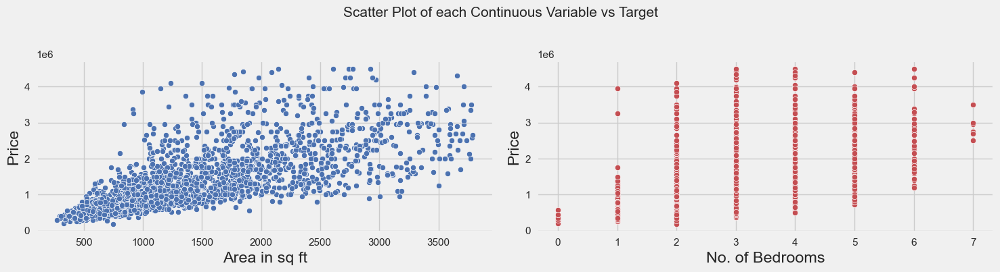

Number of All Scatter Plots = 3


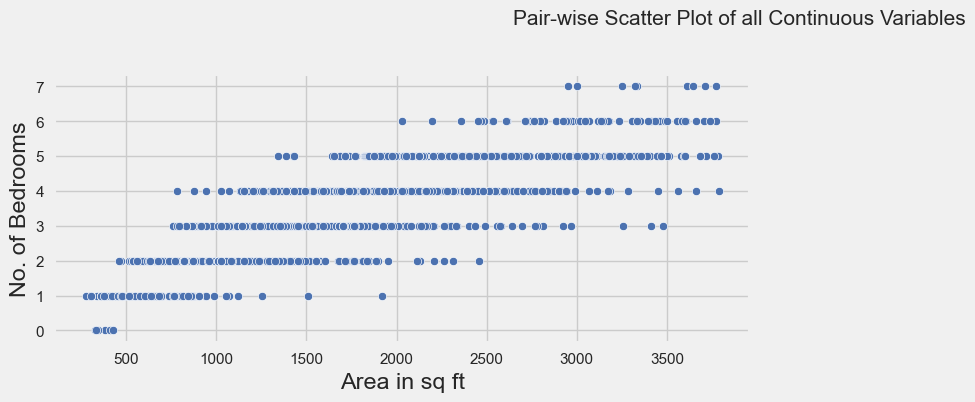

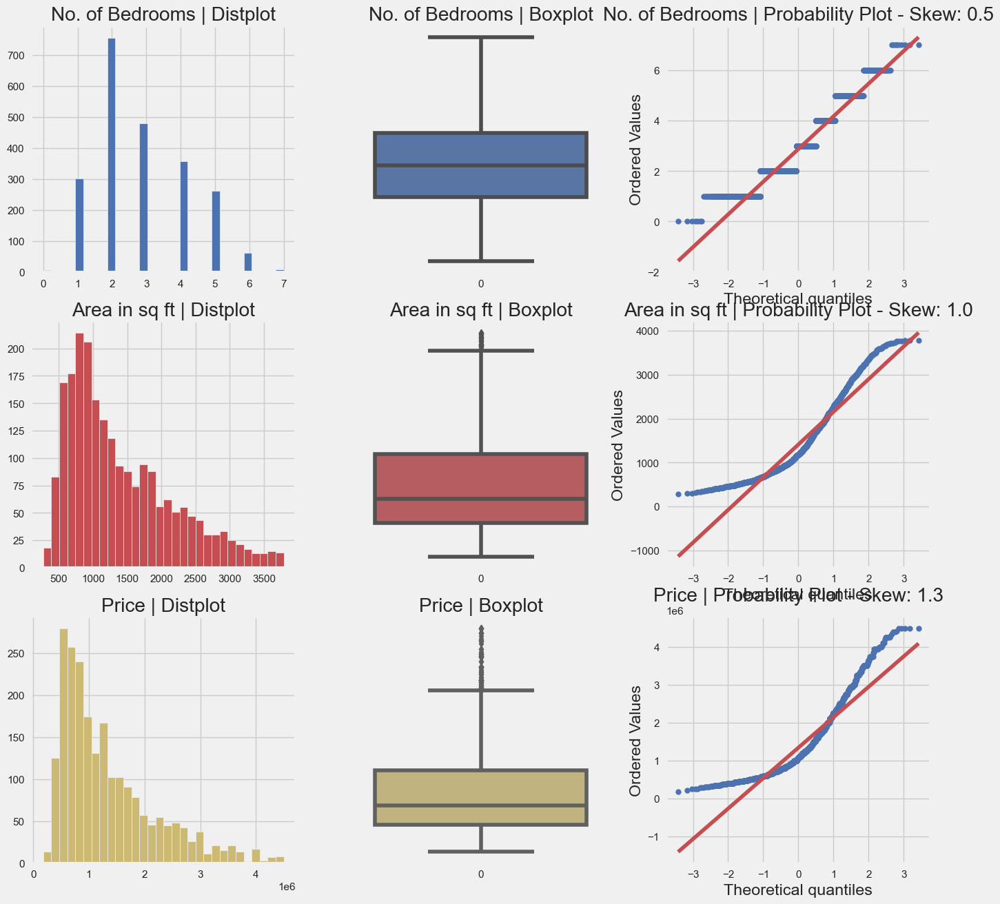

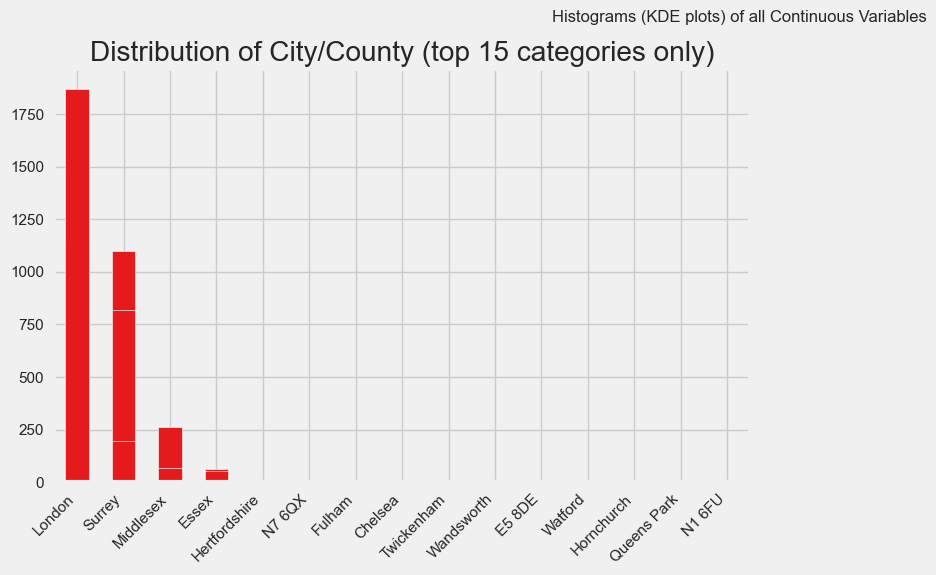

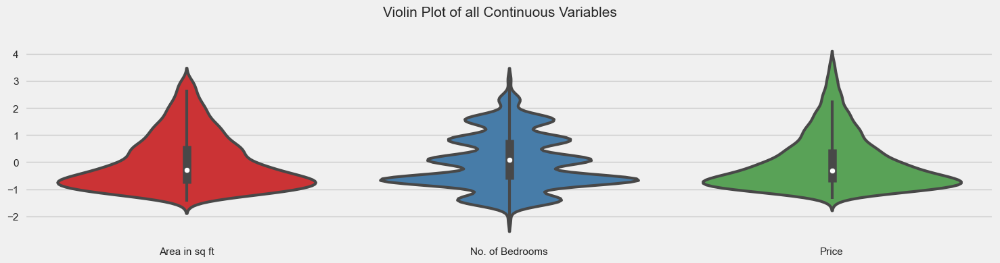

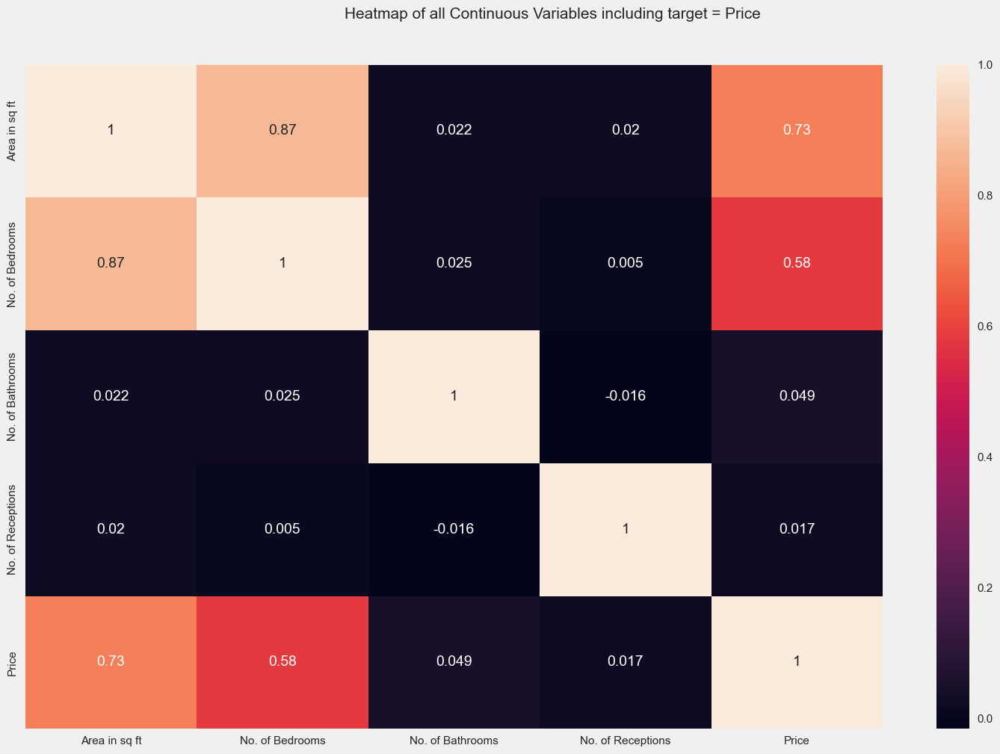

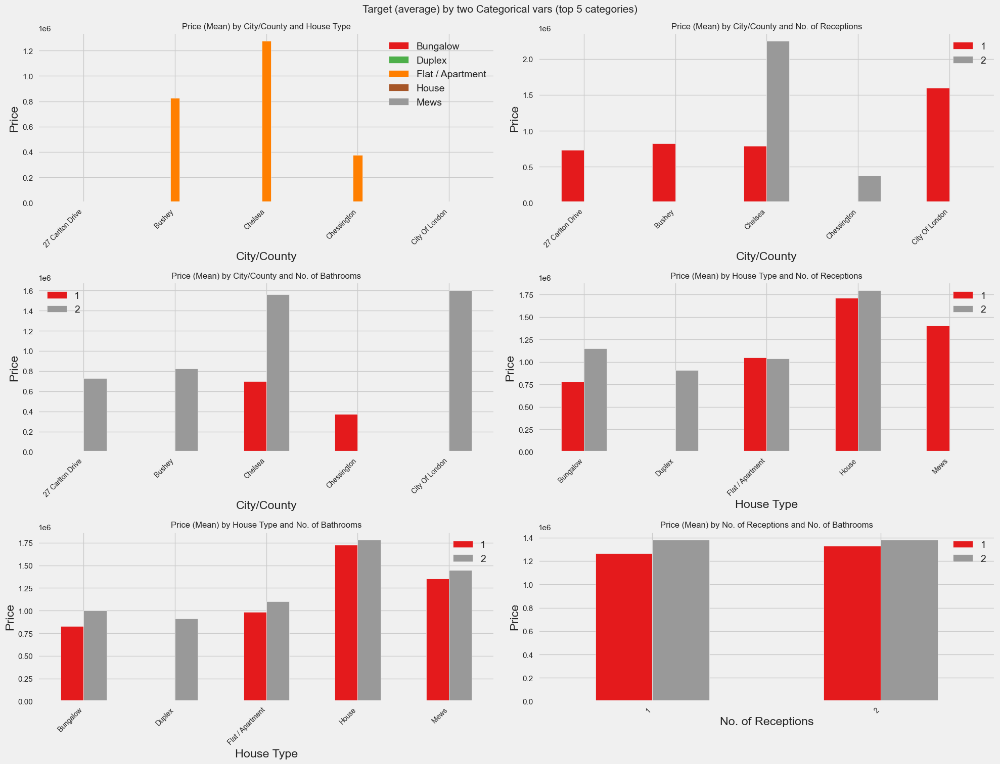

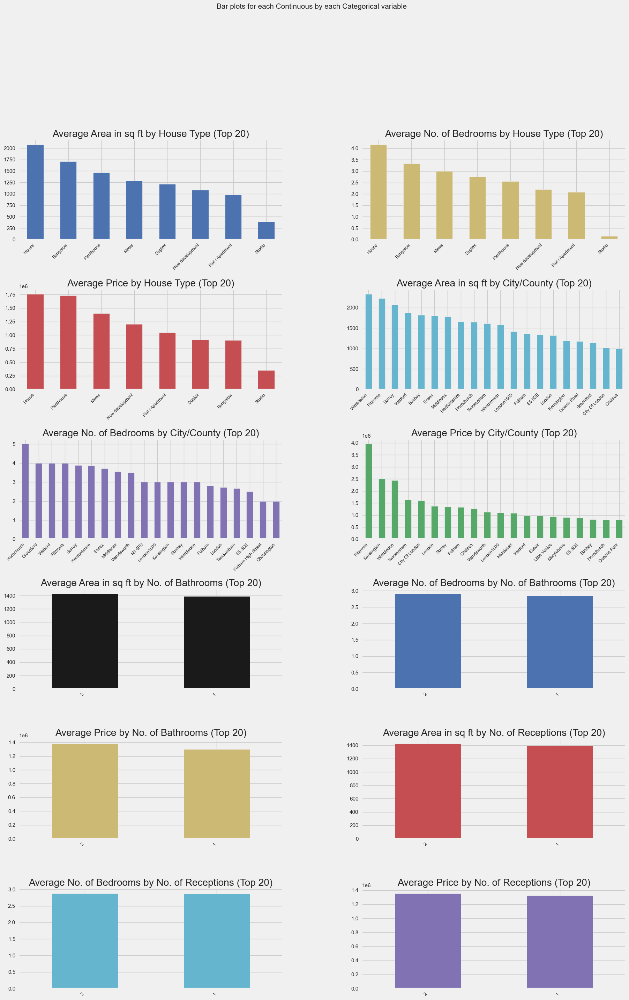

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nl

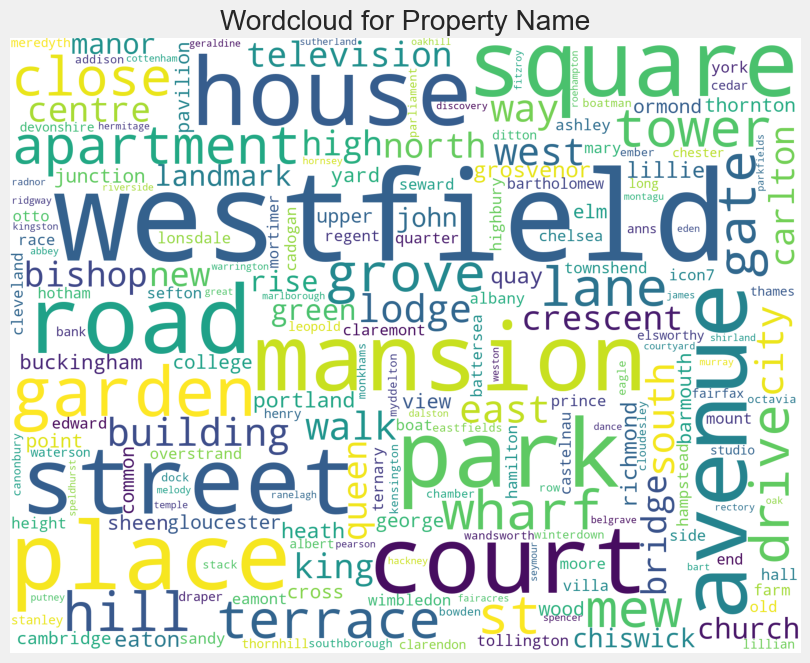

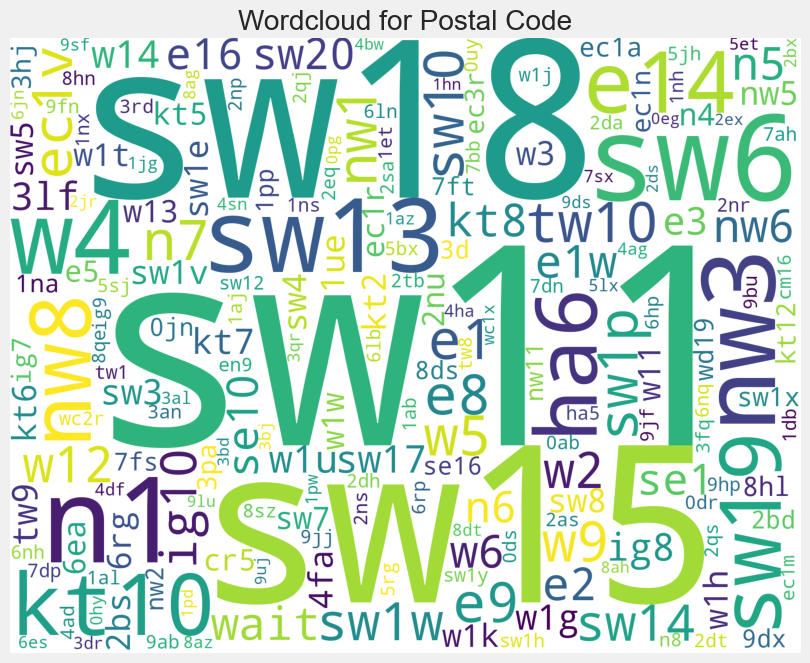

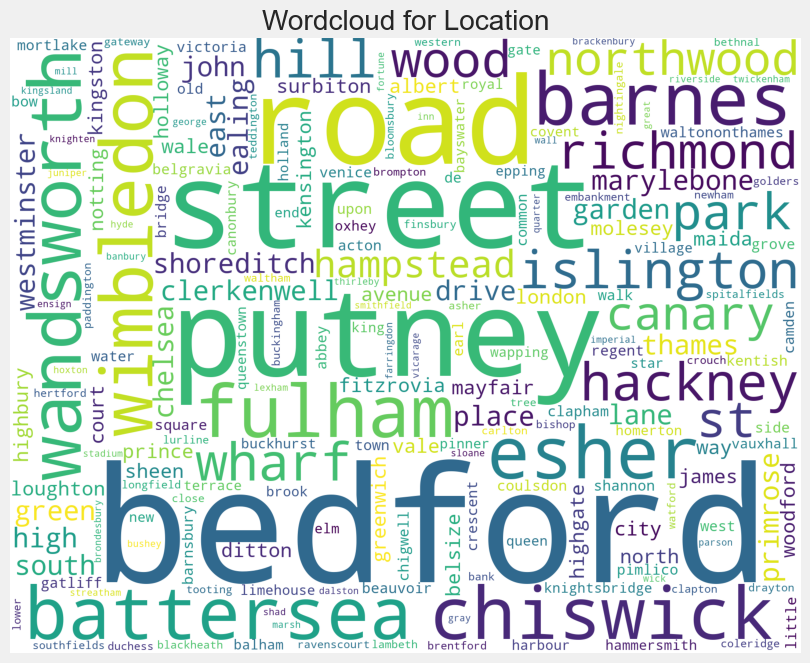

All Plots done
Time to run AutoViz = 15 seconds 

 ###################### AUTO VISUALIZATION Completed ########################
Shape of your Data Set loaded: (2235, 10)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  0
    Number of Integer-Categorical Columns =  2
    Number of String-Categorical Columns =  2
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  2
    Number of Discrete String Columns =  1
    Number of NLP String Columns =  2
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    9 Predictors classified...
        No variables removed since no ID or low-inform

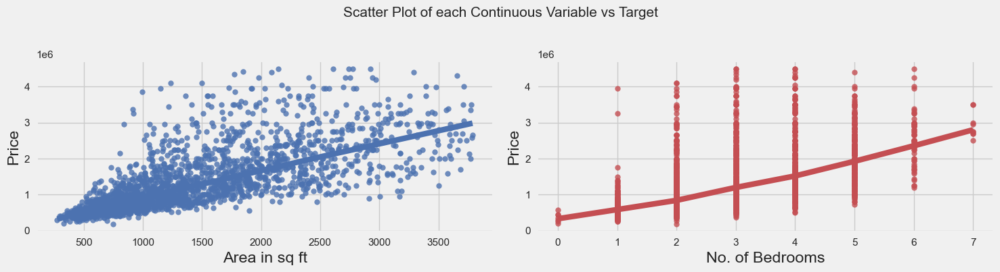

Using Lowess Smoothing. This might take a few minutes for large data sets...
Number of All Scatter Plots = 3


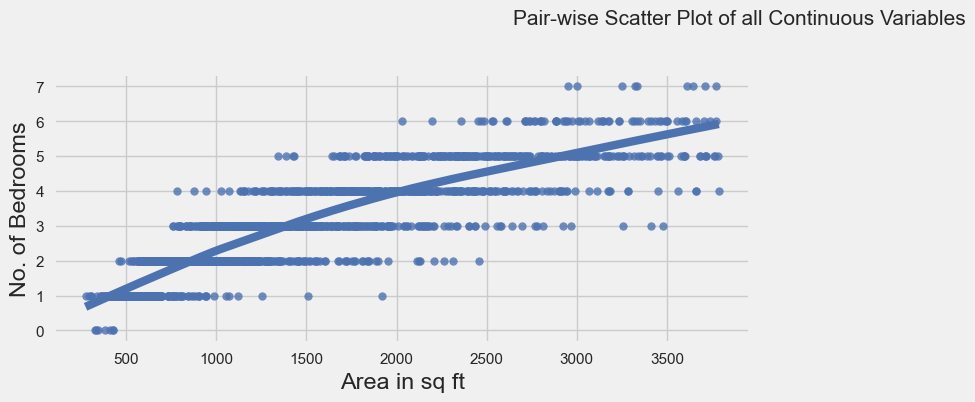

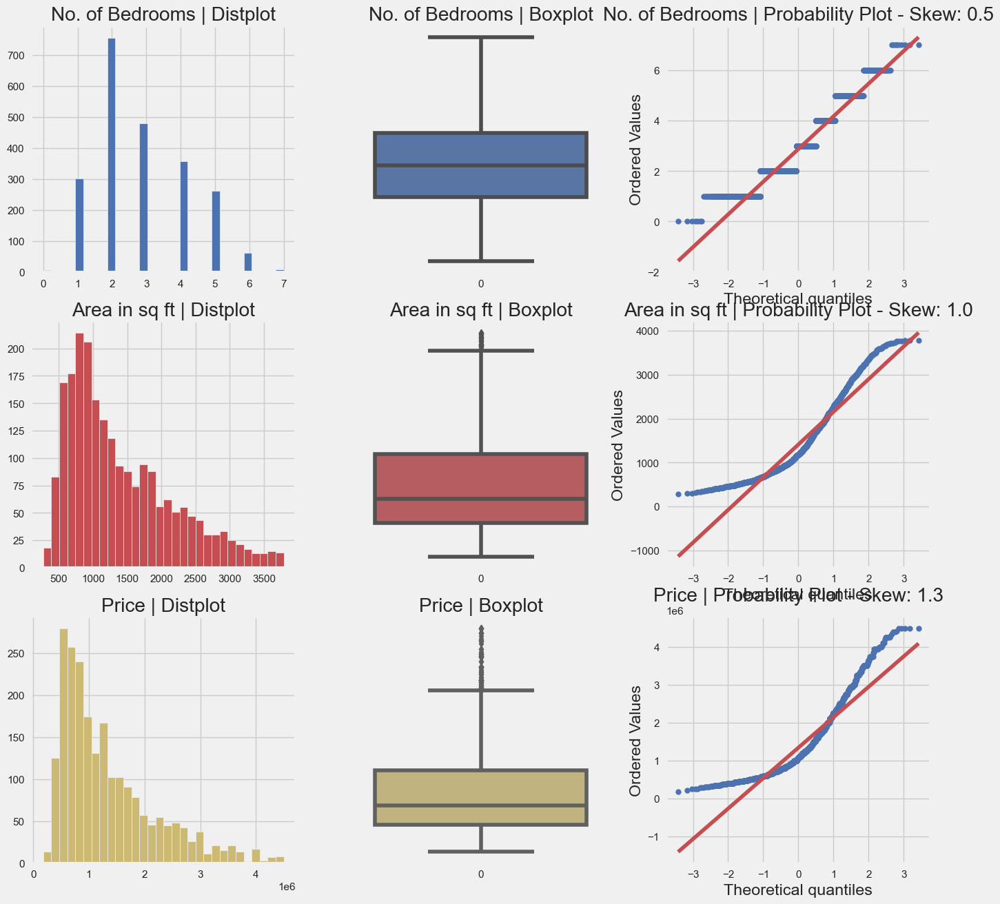

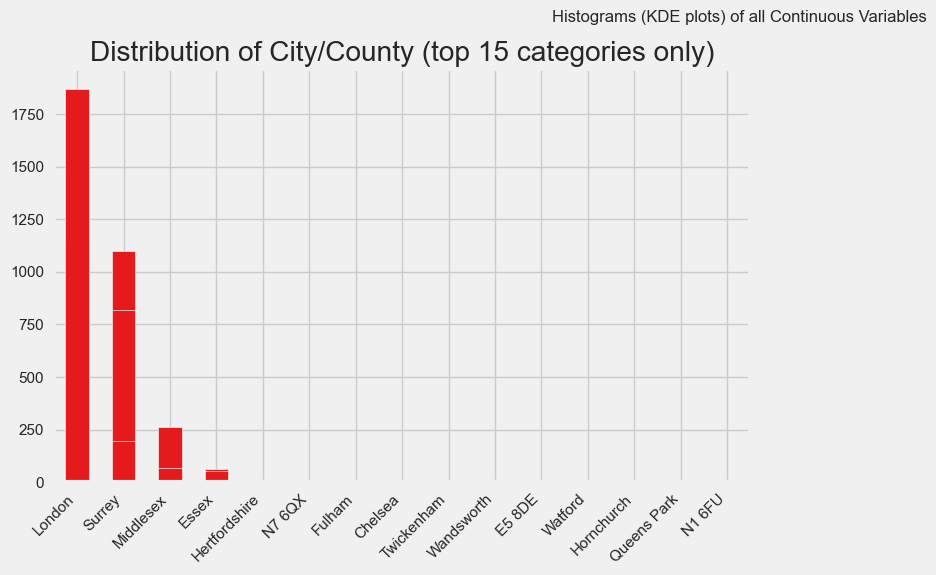

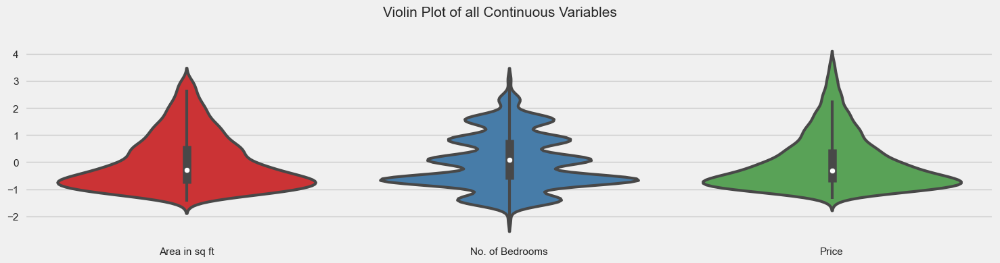

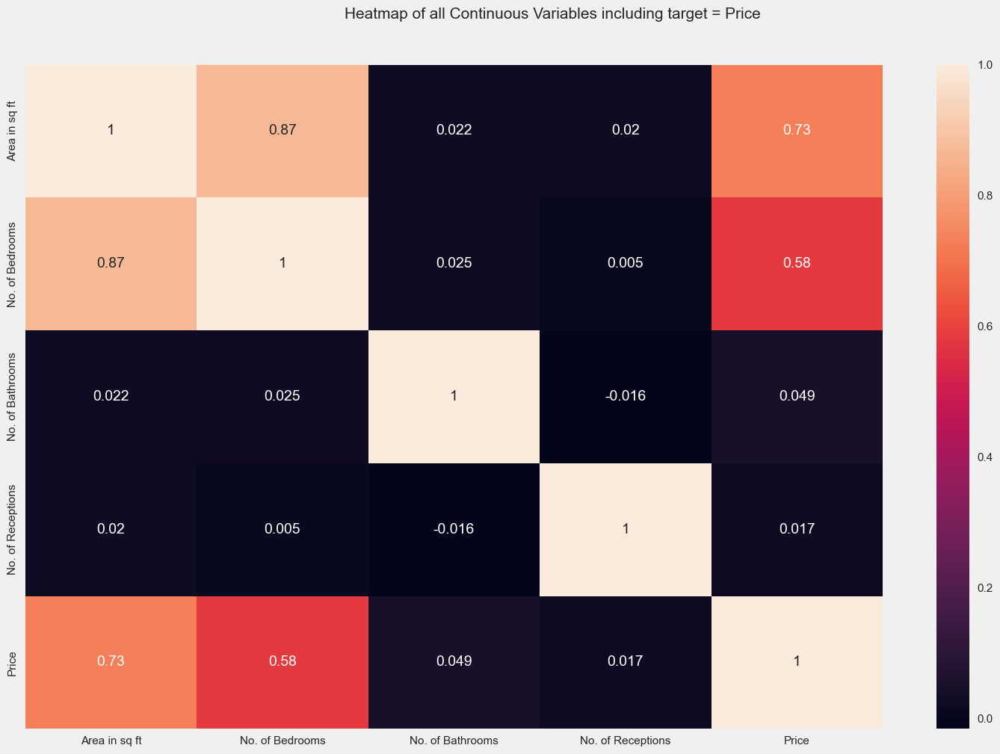

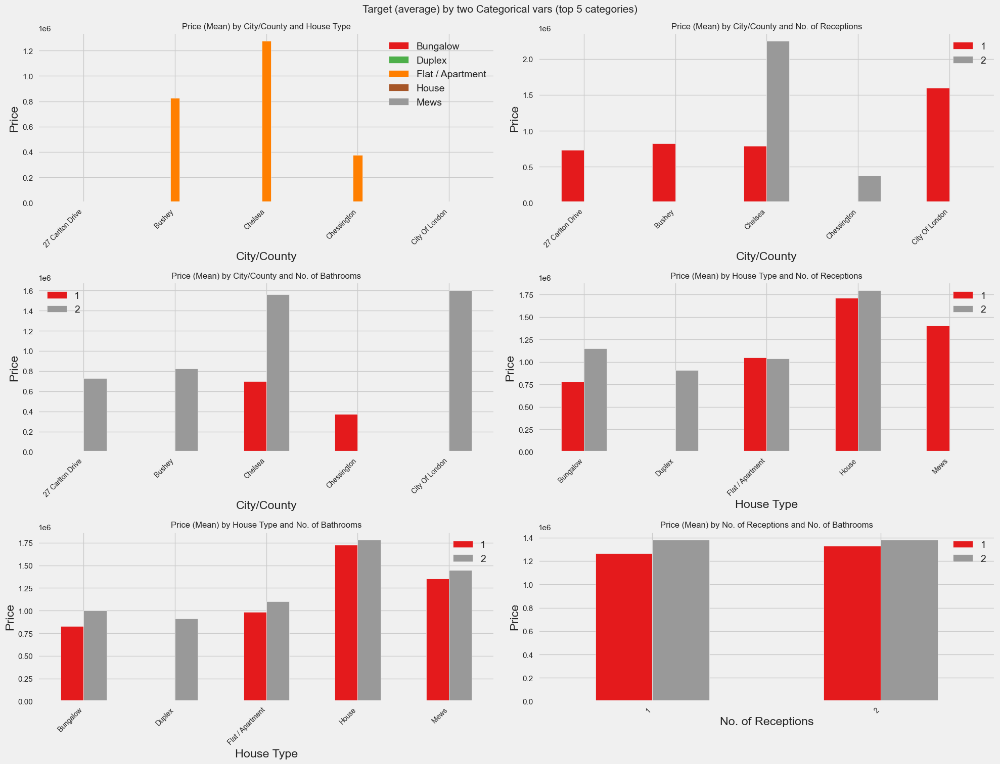

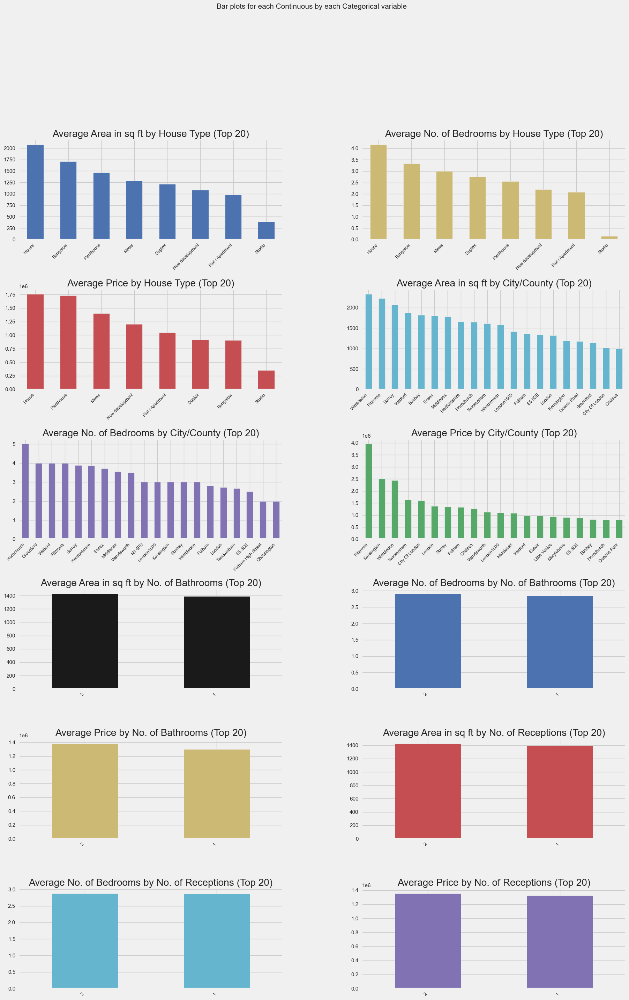

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /Users/irakligrigolia/nltk_data...
[nl

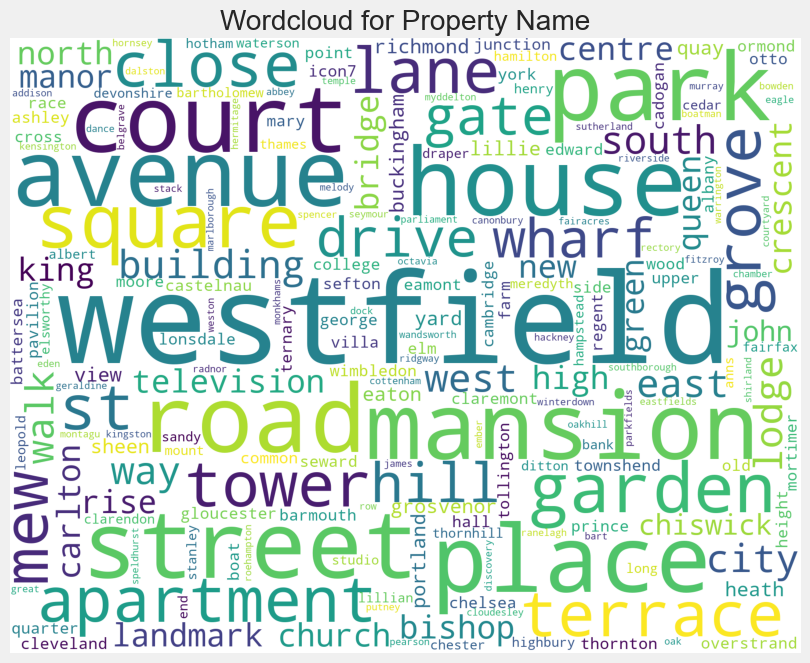

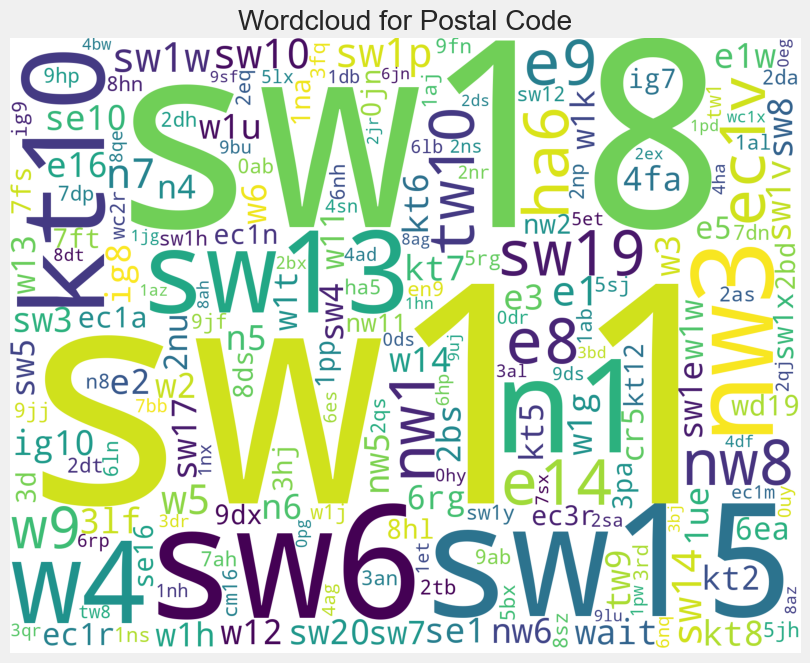

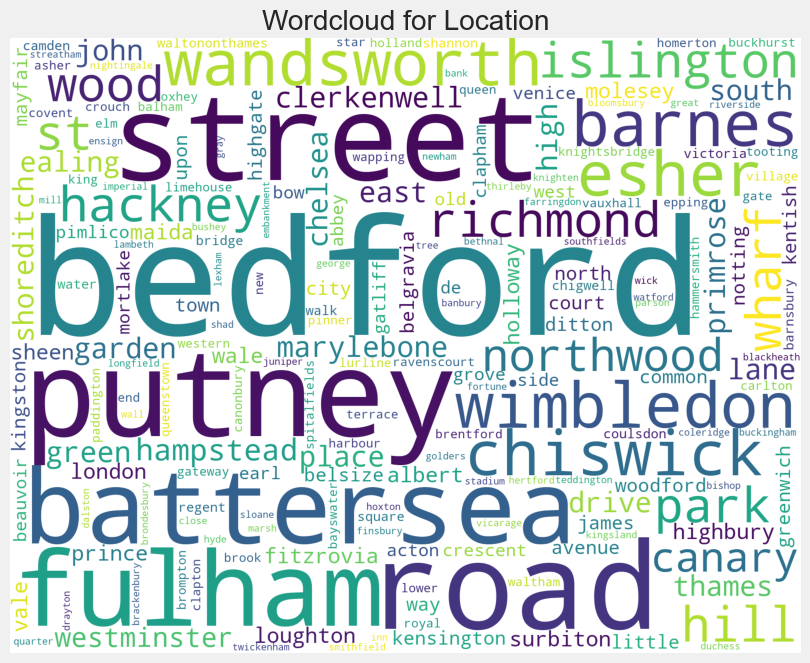

All Plots done
Time to run AutoViz = 16 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


,Property Name,House Type,Area in sq ft,No. of Bedrooms,No. of Bathrooms,No. of Receptions,Location,City/County,Postal Code,Price
0,Queens Road,House,2716,5,1,2,Wimbledon,London,SW19 8NY,1675000
1,Seward Street,Flat / Apartment,814,2,1,1,Clerkenwell,London,EC1V 3PA,650000
2,Hotham Road,Flat / Apartment,761,2,2,1,Putney,London,SW15 1QL,735000
3,Festing Road,House,1986,4,1,2,Putney,London,SW15 1LP,1765000
4,Spencer Walk,Flat / Apartment,700,2,1,2,Putney,London,SW15 1PL,675000
...,...,...,...,...,...,...,...,...,...,...
3462,Lauderdale Drive,House,3176,5,1,2,Richmond,Surrey,TW10 7BS,2150000
3465,Ironmonger Lane,House,3660,4,2,1,The City,London,EC2V 8EY,4300000
3467,Manor Road,House,3286,4,1,1,Loughton,Essex,IG10 4AD,1750000
3468,Claydon House,Flat / Apartment,1080,2,2,1,Waterfront Drive,London,SW10 0DD,1850000


In [21]:
av = AV()
dft = av.AutoViz(
    filename="",
    sep=",",
    depVar= "Price",
    dfte=df,
    header=0,
    verbose=0,
    lowess=False,
    chart_format="svg",
    max_rows_analyzed=150000,
    max_cols_analyzed=30,
)

av.AutoViz(filename = "",sep=',', dfte = df, depVar = 'Price', verbose = 0, lowess = 1)

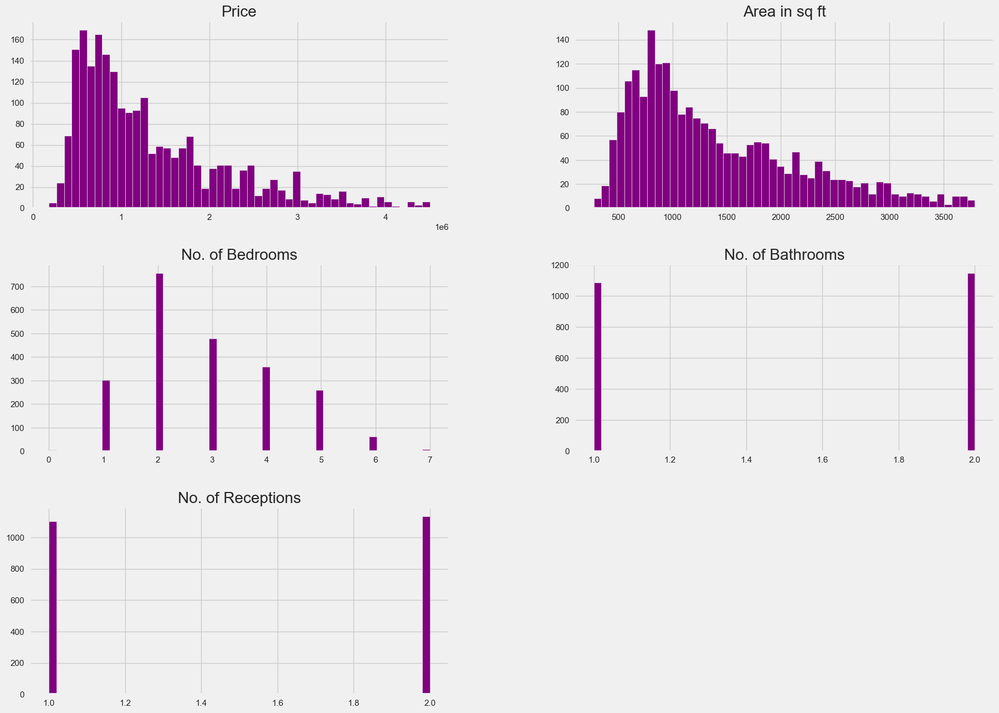

In [22]:
import pylab
import seaborn as sns
%matplotlib inline
# sns.pairplot(df)
# df.hist(color='purple',figsize = (16,18))

# plotting histograms
df.hist(color='purple',bins=50, figsize=(20,15)) 
plt.show()


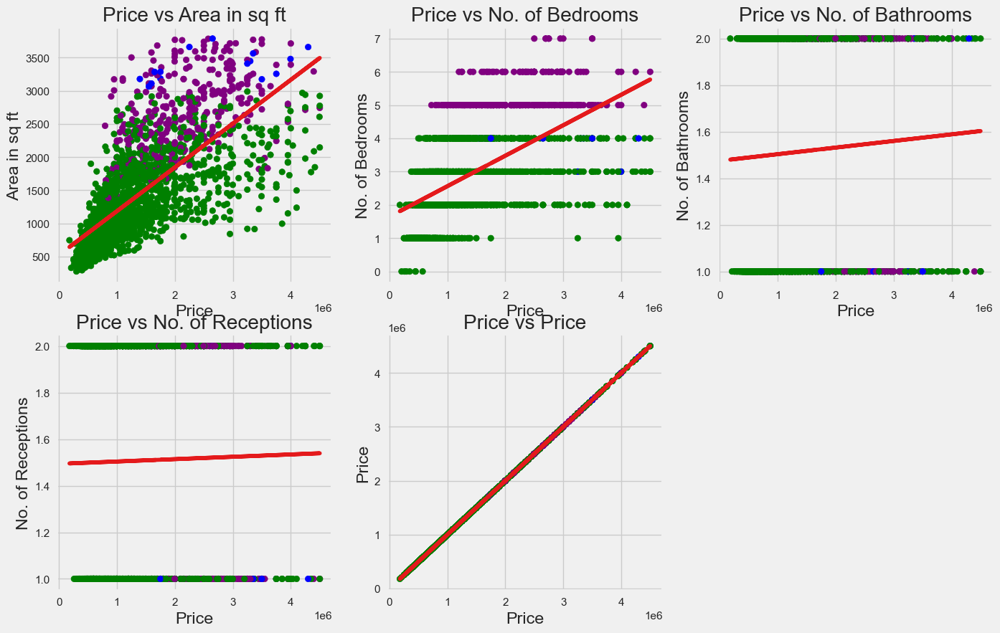

In [23]:
import matplotlib.pyplot as plt

col = np.where(df["No. of Bedrooms"] >= 5,'purple',np.where(df["Area in sq ft"] >= 3000,'blue','green'))

plt.subplot(3, 3, 1) 
reg1 = np.polyfit(df["Price"], df["Area in sq ft"],deg=1)
trend1 = np.polyval(reg1, df["Price"])
plt.scatter(df["Price"], df["Area in sq ft"],c=col)
plt.title("Price vs Area in sq ft")
plt.xlabel('Price')
plt.ylabel('Area in sq ft')
plt.plot(df["Price"], trend1)

plt.subplot(3, 3, 2) 
plt.scatter(df["Price"], df["No. of Bedrooms"],c=col)
reg2 = np.polyfit(df["Price"], df["No. of Bedrooms"],deg=1)
trend2 = np.polyval(reg2, df["Price"])
plt.title("Price vs No. of Bedrooms")
plt.xlabel('Price')
plt.ylabel('No. of Bedrooms')
plt.plot(df["Price"], trend2)


plt.subplot(3, 3, 3)
plt.scatter(df["Price"], df["No. of Bathrooms"],c=col)
reg3 = np.polyfit(df["Price"], df["No. of Bathrooms"],deg=1)
trend3 = np.polyval(reg3, df["Price"])
plt.title("Price vs No. of Bathrooms")
plt.xlabel('Price')
plt.ylabel('No. of Bathrooms')
plt.plot(df["Price"], trend3)


plt.subplot(3, 3, 4)
plt.scatter(df["Price"], df["No. of Receptions"],c=col)
reg4 = np.polyfit(df["Price"], df["No. of Receptions"],deg=1)
trend4 = np.polyval(reg4, df["Price"])
plt.title("Price vs No. of Receptions")
plt.xlabel('Price')
plt.ylabel('No. of Receptions')
plt.plot(df["Price"], trend4)



plt.subplot(3, 3, 5)
plt.scatter(df["Price"], df["Price"],c=col)
reg5 = np.polyfit(df["Price"], df["Price"],deg=1)
trend5 = np.polyval(reg5, df["Price"])
plt.title("Price vs Price")
plt.xlabel('Price')
plt.ylabel('Price')
plt.gcf().set_size_inches((15, 15))
plt.plot(df["Price"], trend5)




plt.show()

In [24]:
import plotly as pl
import plotly.express as px
import plotly.graph_objects as go


x_value = df["No. of Bedrooms"].value_counts()
x_index = x_value.index

fig = go.Figure(data=[go.Pie(labels = x_index, values= x_value,
                             title='Bedrooms in Flats', textinfo='label+percent',hole=.5)])
fig.show()

From the graphs above we can see some interesting insights. For example:
1) From correlation matrix we can see that the highest correlation is between "Price" and "Area in sq ft"
    as expected. Without taking "Location" into consideration yet.
2) 30.7% of the houses/apartments have 2 bedrooms which is the largest number, 20.6% of the data samples
    have 3 bedrooms and having 8 or more bedrooms is almost an outlier
3) Top 3 most popular city/county is London,Surrey,and Middlesex


# Model Revision(ML)

   Lets use Label encoder and trasform categorical values into numerical, and add new feature called 'Total No. of Rooms' and plot correletion matrix to see if it gives some insights.
   
  I used spearman correlation which is a non-parametric rank correlation measure
that evaluates how effectively a monotonic function can capture the connection between two variables. While Pearson's correlation evaluates linear relationships, Spearman's correlation evaluates monotonic relationships; the Spearman's correlation between two variables is equivalent to the Pearson correlation between the rank values of those two variables (whether linear or not).

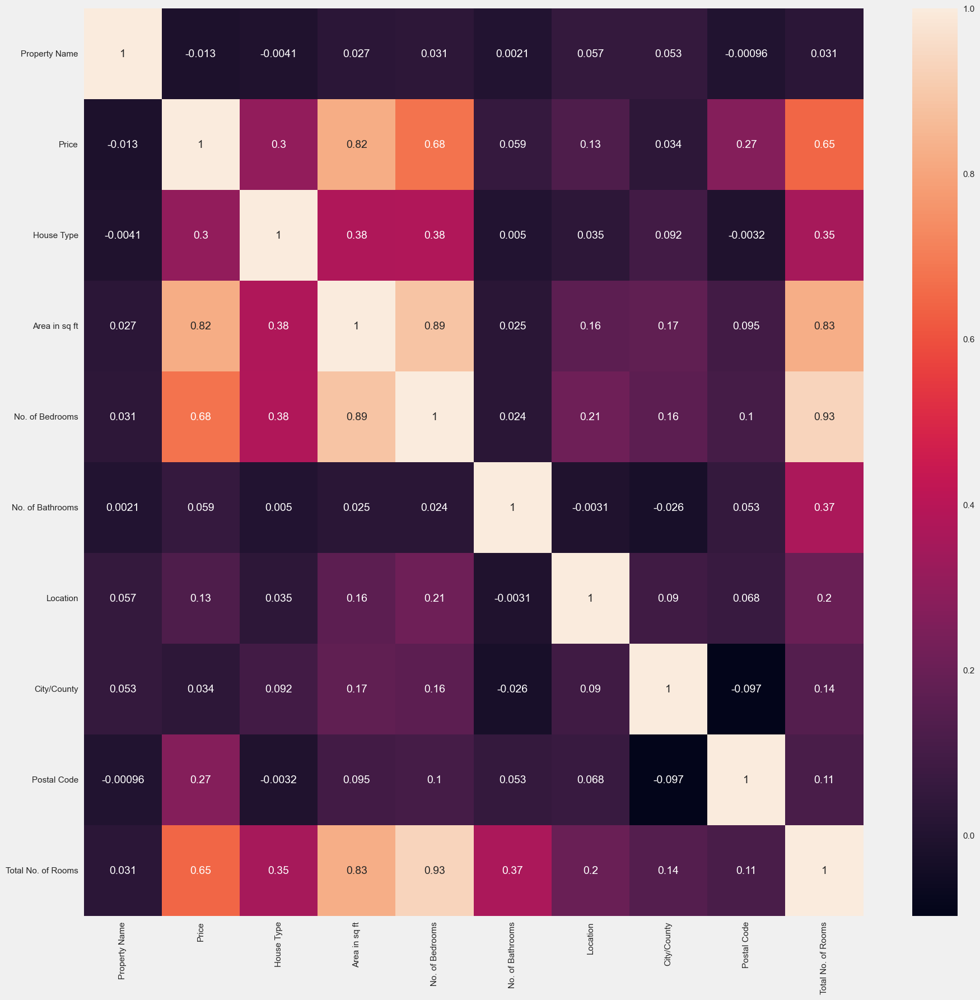

,Property Name,Price,House Type,Area in sq ft,No. of Bedrooms,No. of Bathrooms,Location,City/County,Postal Code,Total No. of Rooms
0,1193,1675000,3,2716,5,1,610,19,1268,6
1,1308,650000,2,814,2,1,354,19,250,3
2,796,735000,2,761,2,2,523,19,1052,4
3,596,1765000,3,1986,4,1,523,19,1042,5
4,1349,675000,2,700,2,1,523,19,1046,3
...,...,...,...,...,...,...,...,...,...,...
3462,886,2150000,3,3176,5,1,531,27,1531,6
3465,816,4300000,3,3660,4,2,104,19,261,6
3467,955,1750000,3,3286,4,1,70,10,330,5
3468,364,1850000,2,1080,2,2,113,19,841,4


In [25]:
df_3 = df.copy()

df_3['Total No. of Rooms'] =  df_3['No. of Bedrooms'] + df_3['No. of Bathrooms']
# df_3["Price Per Sqr. Inch"] = df_3["Price"]/df_3["Area in sq ft"]
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
location_class = encoder.fit_transform(df_3['Location'].values)
house_type_class = encoder.fit_transform(df_3['House Type'].values)
postal_code_class = encoder.fit_transform(df_3['Postal Code'].values)
property_class = encoder.fit_transform(df_3['Property Name'].values)
city_county_class = encoder.fit_transform(df_3['City/County'].values)

df_3['Location'] = location_class
df_3['House Type'] = house_type_class
df_3['Postal Code'] = postal_code_class
df_3['Property Name'] = property_class
df_3['City/County'] = city_county_class

df_3 = df_3.drop(columns=["No. of Receptions"])
# df_3 = df_3.drop(columns=["No. of Bathrooms"])



corrMatrix = df_3.corr(method='spearman')
sns.heatmap(corrMatrix, annot=True)



plt.gcf().set_size_inches((20, 20))    
plt.show()
df_3




Although there is not much correlation between transformed features and price, new feature has 0.65 correlation index against price which should be useful.

# Performance Metrics
For the evaluation metrics I will use Mean Absolute Percentage Error (MAPE) and Mean Absolute Error (MAE).

1) Mean Absolute Percentage Error is one of the most common metrics of model prediction accuracy and the percentage equivalent of MAE. MAPE measures the average magnitude of error produced by a model, or how far off predictions are on average. 

2) Mean Absolute Error  is the magnitude of the difference between the individual measurement and the true value of the quantity is called the absolute error of the measurement. The arithmetic mean of all the absolute error is taken as the mean absolute error of the value of the physical quantity

Using MAPE we can evaluate accuracy of our model. So for example if MAPE value is ~0.5, that means that our model is correct only approximately 50% of the times which would not be good. On contrary, if MAPE score is 0.2 or less that means that model accuracy is 80% or more and that means that we achieved the score we initially aimed for which would be a success.

In addition to MAPE using MAE we can tell by how much our model misses the target. For example if MAE score is 200000 that would mean that on average our model is off by $20000.

Goal is to get both MAPE and MAE scores as small as possible.


Other measures I looked into were Median Absolute Error, R2_score and Mean Poisson Deviance, but in the end I chose MAPE and MAE  because I find them easier to interpret.
    
    




Lets use Log transform in order to normalize the distribuion of the data. Log transform can make highly skewed distributions less skewed. So log transform reduces or removes skewness in data. Even though, my data is not that heavily skewed we can notice that model's performance has increased.

## Linear Regresion

Now, lets try different regression models and find out which one performs the best.
    First one is Linear Regression


Mean Absolute Percentage Error: 30
Mean Absolute Rrror: 408190
Mean squared error: 465093452164.59
Coefficient of determination: 0.44


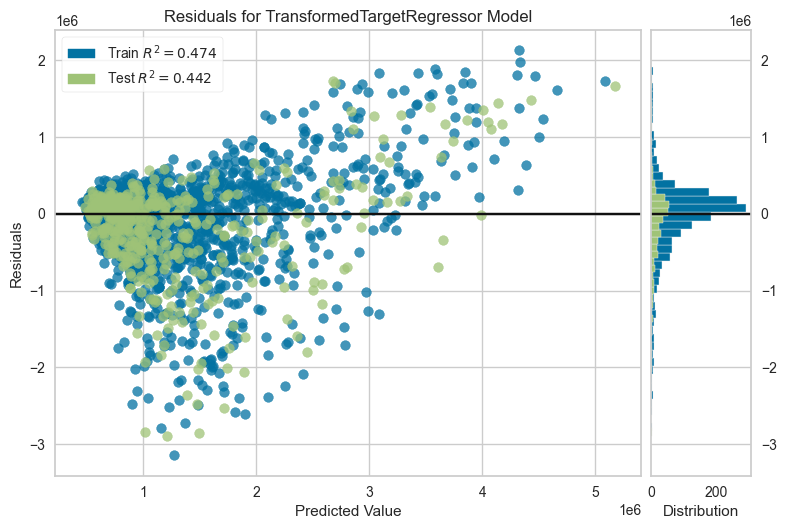

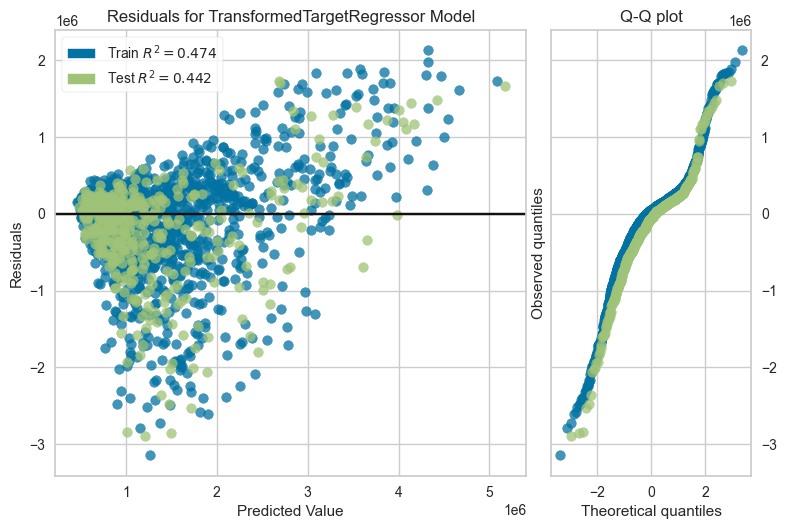

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [26]:
from sklearn.preprocessing import OneHotEncoder, FunctionTransformer, StandardScaler
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.compose import make_column_transformer, TransformedTargetRegressor
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from yellowbrick.regressor import ResidualsPlot


regr = LinearRegression()

X, y = df_3.drop(['Price','Property Name','No. of Bathrooms','Location','City/County'], axis = 1), df_3['Price']


preparer = make_column_transformer(
('passthrough', ['No. of Bedrooms','Postal Code','Area in sq ft','Total No. of Rooms','House Type']))
reg_pipeline = make_pipeline(preparer,regr)
#use log tranform
transformed_pipeline = TransformedTargetRegressor(reg_pipeline , func = np.log, inverse_func = np.exp)

reg_mape = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_percentage_error'))
reg_mae = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_error'))


print("Mean Absolute Percentage Error:", round(reg_mape *100))
print("Mean Absolute Rrror:", round(reg_mae))


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)


transformed_pipeline.fit(X_train,y_train)
y_pred = transformed_pipeline.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipeline)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()  


visualizer = ResidualsPlot(transformed_pipeline, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()



A common use of the residuals plot is to analyze the variance of the error of the regressor. If the points are randomly dispersed around the horizontal axis, a linear regression model is usually appropriate for the data; otherwise, a non-linear model is more appropriate. In the case above, we see a fairly random, uniform distribution of the residuals against the target in two dimensions. This seems to indicate that our linear model is performing well. We can also see from the histogram that our error is normally distributed around zero, which also generally indicates a well fitted model.

Histogram can be replaced with a Q-Q plot, which is a common way to check that residuals are normally distributed. If the residuals are normally distributed, then their quantiles when plotted against quantiles of normal distribution should form a straight line. 

I will be plotting ressiduals and Q-Q plot for every algorithm I use

As we can see our model predicts the correct value of the price 30% of the times on average. When its prediction is wrong, it is off  by $408190 and Coefficient of determination is 0.44 which is not so good.
Let's move on to next algorithm.

# Gradient Boosting Regression

"Boosting" is a technique for fusing many straightforward models into a single composite model. Due to the addition of single simple models (also known as weak learners) while maintaining the integrity of the model's current trees, boosting is also known as an additive model. The final, full model improves as we merge more and more basic models, making it a better predictor. Since the process employs gradient descent to minimize the loss, the name "gradient" in "gradient boosting" refers to this technique. 


Mean Absolute Percentage Error: 17.0
Mean Absolute Error: 236759
Mean squared error: 173010334178.98
Coefficient of determination: 0.79


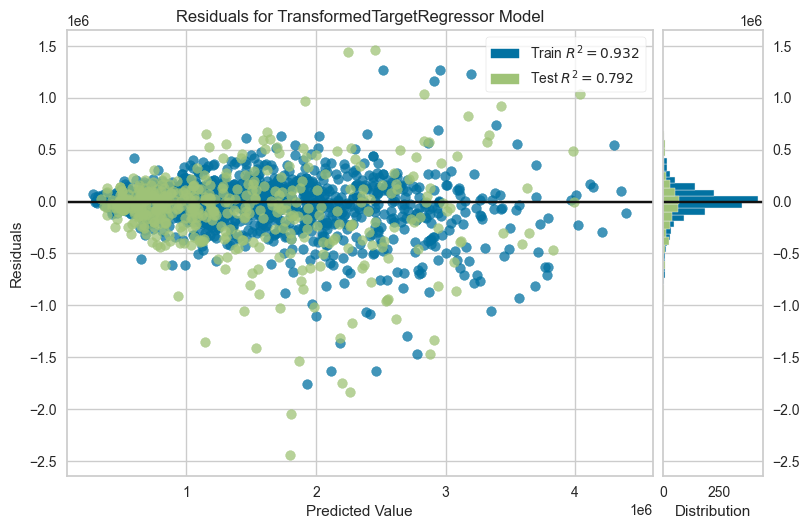

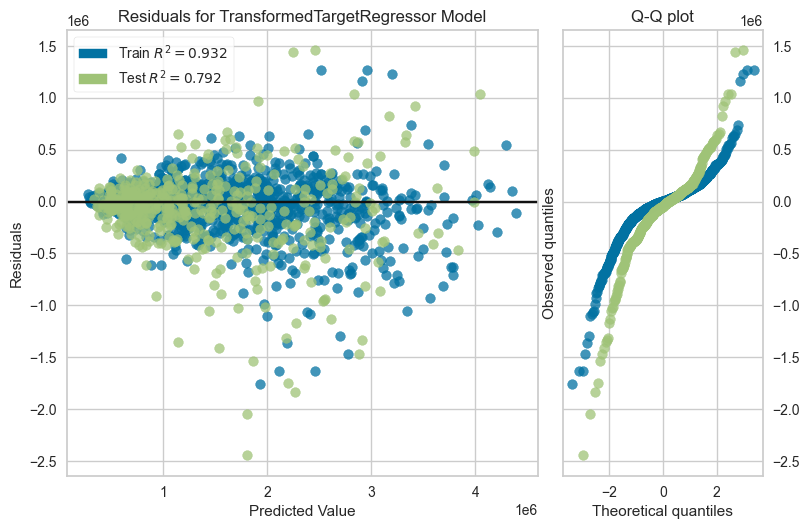

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [27]:
regressor = GradientBoostingRegressor(n_estimators = 100000000, n_iter_no_change = 250,
                                      validation_fraction = 0.2, learning_rate = 0.1)


# Combine the preparer and regressor into one pipeline
gbr_pipeline = make_pipeline(preparer, regressor)

# This transforms the target variable before fitting the model,
# but gives out actual (back-transformed) prediction results automatically.
transformed_pipline = TransformedTargetRegressor(gbr_pipeline , func = np.log, inverse_func = np.exp)

mape_gbr = -np.mean(cross_val_score(transformed_pipline, X, y, scoring = 'neg_mean_absolute_percentage_error'))
mae_gbr = -np.mean(cross_val_score(transformed_pipline, X, y, scoring = 'neg_mean_absolute_error'))

print("Mean Absolute Percentage Error:", round(mape_gbr,2) *100)
print("Mean Absolute Error:", round(mae_gbr))


transformed_pipline.fit(X_train,y_train)
y_pred = transformed_pipline.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipline)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()



visualizer = ResidualsPlot(transformed_pipline, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()



As we can see, MAPE is 17% and MAE is $232476 which is significantly better than regular regression model and determination coefficient is also really good with 0.79.

Next I want to try two regression techniques: Lasso and Ridge Regressions.
Ridge and Lasso regression are some of the simple techniques to reduce model complexity and prevent over-fitting which may result from simple linear regression.

Lets find out if it gives any performance improvements.

# Ridge Regression


Mean Absolute Percentage Error: 30.0
Mean Absolute Error: 408186
Mean squared error: 465121973235.34
Coefficient of determination: 0.44


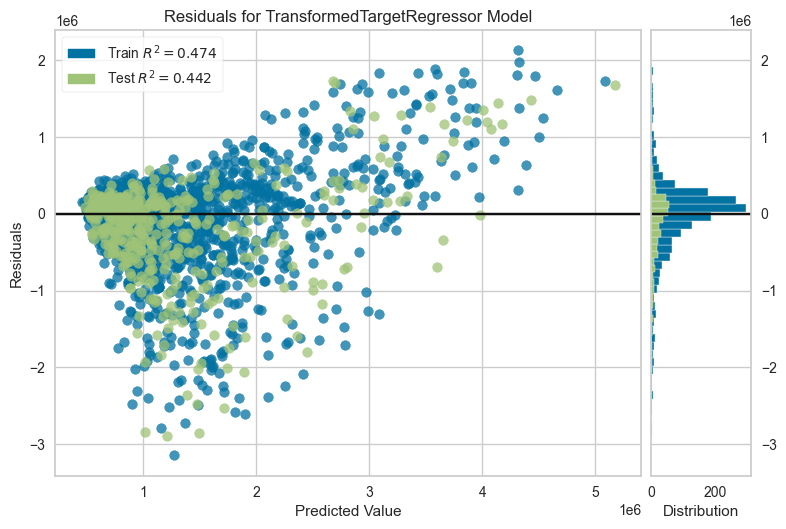

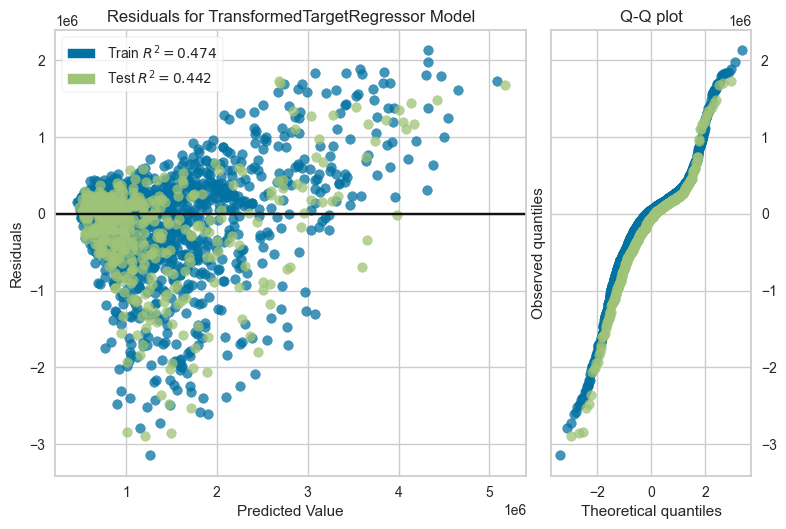

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [28]:
from sklearn.linear_model import Ridge

ridge_regressor = Ridge(alpha=1.0)
ridge_pipeline = make_pipeline(preparer, ridge_regressor)

# This transforms the target variable before fitting the model,
# but gives out actual (back-transformed) prediction results automatically.
transformed_pipline = TransformedTargetRegressor(ridge_pipeline , func = np.log, inverse_func = np.exp)


mape_ridge = -np.mean(cross_val_score(transformed_pipline, X, y, scoring = 'neg_mean_absolute_percentage_error'))
mae_ridge = -np.mean(cross_val_score(transformed_pipline, X, y, scoring = 'neg_mean_absolute_error'))


print("Mean Absolute Percentage Error:", round(mape_ridge,2) *100)
print("Mean Absolute Error:", round(mae_ridge))


transformed_pipline.fit(X_train,y_train)
y_pred = transformed_pipline.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipline)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()



visualizer = ResidualsPlot(transformed_pipline, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()




# Lasso Regression

Mean Absolute Percentage Error: 30.0
Mean Absolute Error: 409225
Mean squared error: 477955279971.04
Coefficient of determination: 0.43


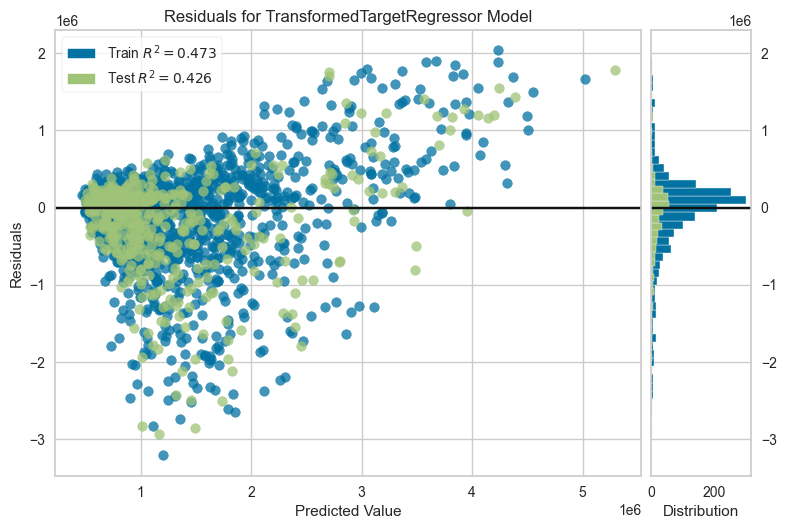

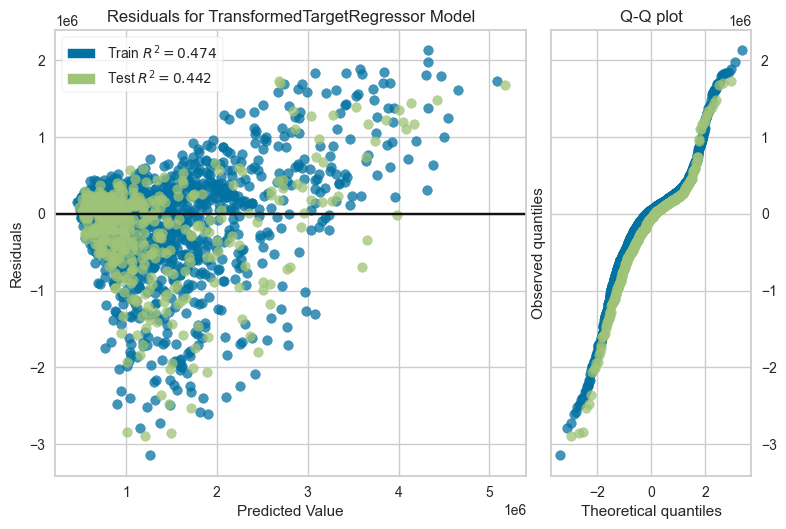

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [29]:
from sklearn import linear_model
lasso_regressor = linear_model.Lasso(alpha=0.1)

lasso_pipeline = make_pipeline(preparer, lasso_regressor)

# This transforms the target variable before fitting the model,
# but gives out actual (back-transformed) prediction results automatically.
transformed_pipeline = TransformedTargetRegressor(lasso_pipeline , func = np.log, inverse_func = np.exp)

mape_lasso = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_percentage_error'))
mae_lasso = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_error'))

print("Mean Absolute Percentage Error:", round(mape_lasso,2) *100)
print("Mean Absolute Error:", round(mae_lasso))


transformed_pipeline.fit(X_train,y_train)
y_pred = transformed_pipeline.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipeline)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()


visualizer = ResidualsPlot(transformed_pipline, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()

As we can see we got a bit better MAPE with both having 30%, but unfotunately MAE is worse compared to GBR and Linear Regression.Coefficient of determination is also same as for Linear Regression which is 0.44

Next, let's try Elestic Net and compare its  performance against other models.

## Elastic Net

Elastic Net is a middle ground between Ridge Regression and Lasso Regression. The regularization term is a simple mix of both Ridge and Lasso’s regularization terms, and you can control the mix ratio r. When r = 0, Elastic Net is equivalent to Ridge Regression, and when r = 1, it is equivalent to Lasso Regression 

Mean Absolute Percentage Error: 30.0
Mean Absolute Error: 409248
Mean squared error: 477955279971.04
Coefficient of determination: 0.43


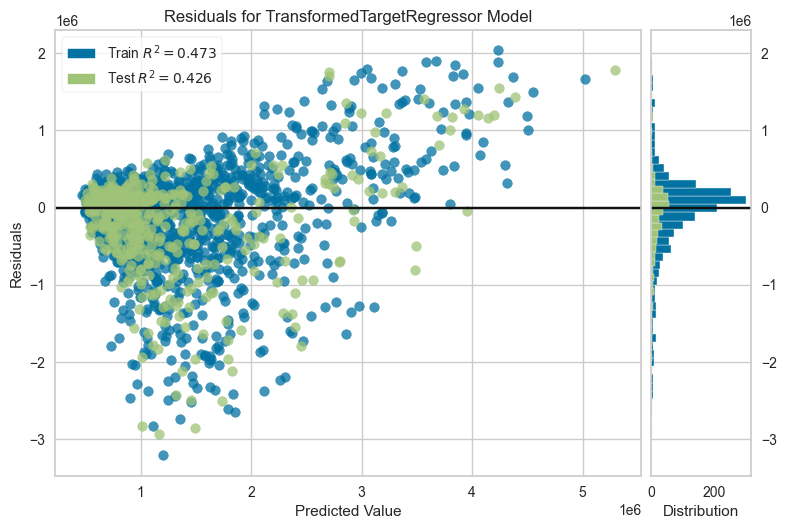

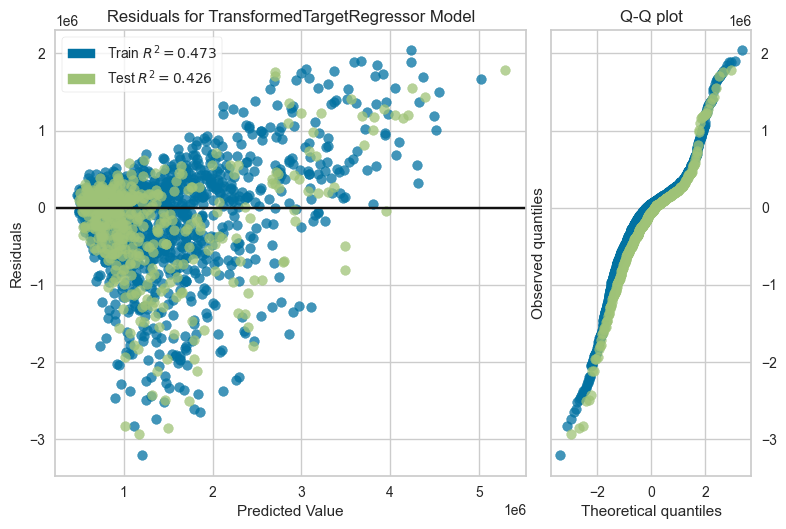

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [30]:
from sklearn.linear_model import ElasticNet
elastic_net = ElasticNet(alpha=0.1, l1_ratio=0.5)
en_pipeline = make_pipeline(preparer,elastic_net)


# This transforms the target variable before fitting the model,
# but gives out actual (back-transformed) prediction results automatically.
transformed_pipline = TransformedTargetRegressor(en_pipeline , func = np.log, inverse_func = np.exp)

mape_en = -np.mean(cross_val_score(transformed_pipline, X, y, scoring = 'neg_mean_absolute_percentage_error'))
mae_en = -np.mean(cross_val_score(transformed_pipline, X, y, scoring = 'neg_mean_absolute_error'))

print("Mean Absolute Percentage Error:", round(mape_en,2) *100)
print("Mean Absolute Error:", round(mae_en))


transformed_pipeline.fit(X_train,y_train)
y_pred = transformed_pipeline.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipeline)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()

visualizer = ResidualsPlot(transformed_pipline, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()

No improvment can be seen. MAPE is still 30% and coefficient of determination is 0.43.

Next, as suggested by a fellow student I want to try Ensemble methods, specifically Bagging Regression and supervised model called Support Vector Machine to see if any of them give us boost in performance.

## Bagging Regression

First lets start with Bagging Regression. A Bagging regressor is an ensemble meta-estimator that fits base regressors each on random subsets of the original dataset and then aggregate their individual predictions (either by voting or by averaging) to form a final prediction. Such a meta-estimator can typically be used as a way to reduce the variance of a black-box estimator (e.g., a decision tree), by introducing randomization into its construction procedure and then making an ensemble out of it.

Mean Absolute Percentage Error: 21.0
Mean Absolute Error: 287158
Mean squared error: 233754588402.66
Coefficient of determination: 0.72


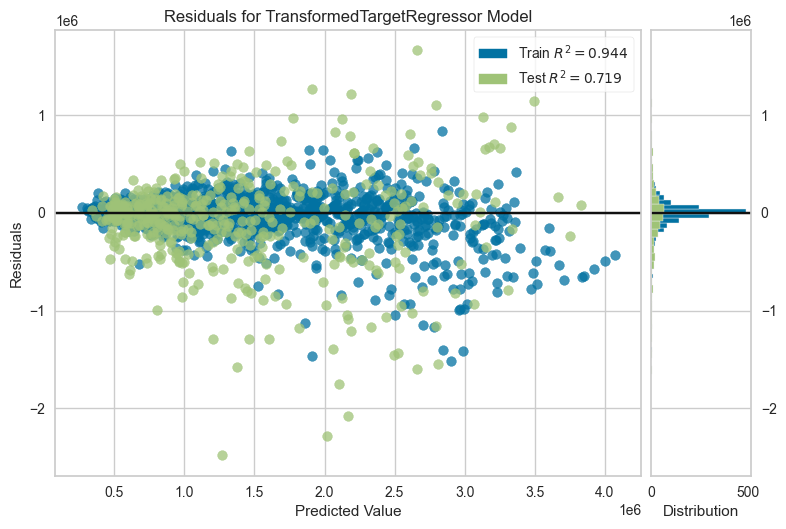

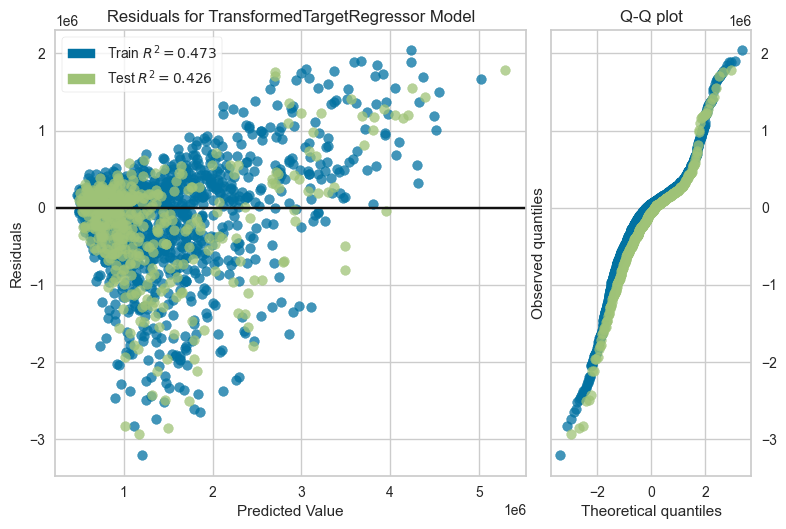

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [31]:
from sklearn.ensemble import BaggingRegressor

bagging_regressor = BaggingRegressor(n_estimators=10, random_state=0)
bagging_pipeline = make_pipeline(preparer, bagging_regressor)

# This transforms the target variable before fitting the model,
# but gives out actual (back-transformed) prediction results automatically.
transformed_pipeline = TransformedTargetRegressor(bagging_pipeline , func = np.log, inverse_func = np.exp)

mape_bag = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_percentage_error'))
mae_bag = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_error'))

print("Mean Absolute Percentage Error:", round(mape_bag,2) *100)
print("Mean Absolute Error:", round(mae_bag))


transformed_pipeline.fit(X_train,y_train)
y_pred = transformed_pipeline.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipeline)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()



visualizer = ResidualsPlot(transformed_pipline, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()


As we can see it performs significantly better than regular Linear Regression as well as Lasso and Ridge Regression. MAPE is 21% which means accuracy is 79% and MAE is $287158 is is good but still worse than GBR.

## Support Vector Machine

Next, Lets try Support Vector Regression and see how it performs.
The objective of a support vector machine algorithm is to find a hyperplane in an n-dimensional space that distinctly classifies the data points. The data points on either side of the hyperplane that are closest to the hyperplane are called Support Vectors. These influence the position and orientation of the hyperplane and thus help build the SVM.

Mean Absolute Percentage Error: 26.0
Mean Absolute Error: 360079
Mean squared error: 406011567228.09
Coefficient of determination: 0.51


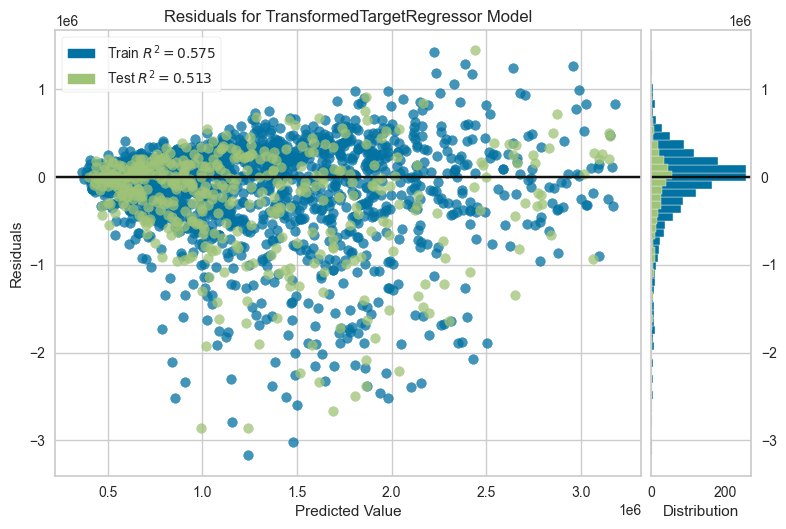

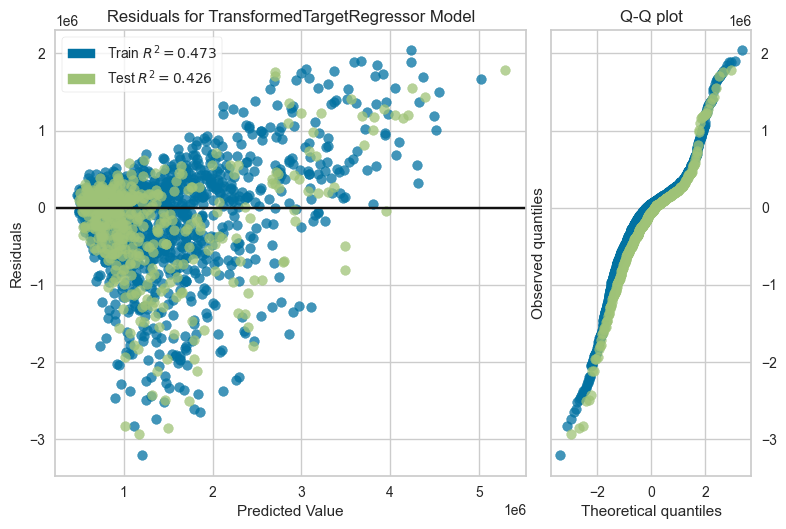

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [32]:
from sklearn.svm import SVR

sv_regr = SVR(kernel="rbf")
sv_pipeline = make_pipeline(preparer, sv_regr)

# This transforms the target variable before fitting the model,
# but gives out actual (back-transformed) prediction results automatically.
transformed_pipeline = TransformedTargetRegressor(sv_pipeline , func = np.log, inverse_func = np.exp)

mape_sv = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_percentage_error'))
mae_sv = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_error'))

print("Mean Absolute Percentage Error:", round(mape_sv,2) *100)
print("Mean Absolute Error:", round(mae_sv))

transformed_pipeline.fit(X_train,y_train)
y_pred = transformed_pipeline.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipeline)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()


visualizer = ResidualsPlot(transformed_pipline, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()



From the results above, we can see that it performs ok with 74% accuracy and with $360079 of MAE but it is still worse than GBR with Coefficient of determination of 0.51

# XGBOOST



XGBoost, which stands for Extreme Gradient Boosting, is a scalable, distributed gradient-boosted decision tree (GBDT) machine learning library. It provides parallel tree boosting and is the leading machine learning library for regression, classification, and ranking problems.

Mean Absolute Percentage Error: 17.0
Mean Absolute Error: 238860
Mean squared error: 173432236591.55
Coefficient of determination: 0.79


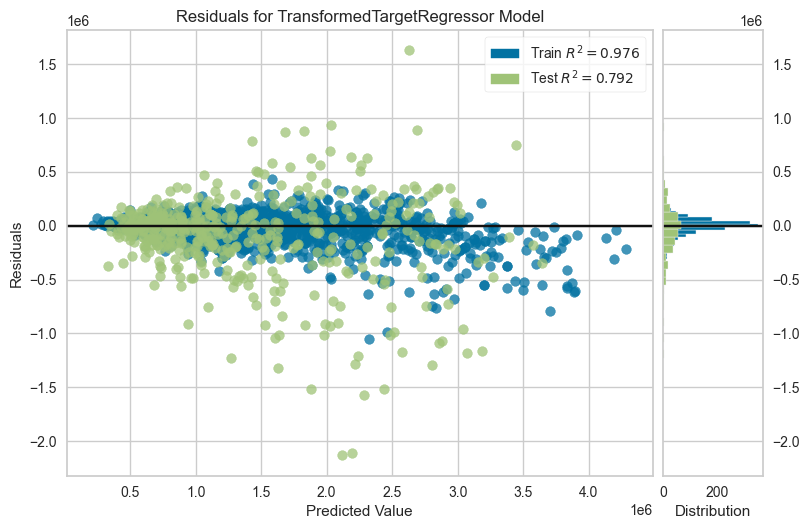

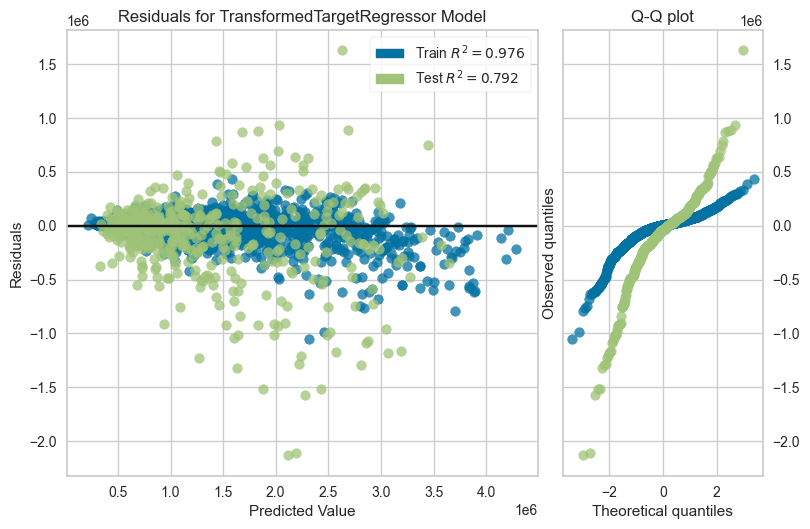

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [33]:
import xgboost as xgb
xgbr = xgb.XGBRegressor(n_estimators=1000, max_depth=10, eta=0.01)

# Combine the preparer and regressor into one pipeline
xgbr_pipeline = make_pipeline(preparer, xgbr)

# This transforms the target variable before fitting the model,
# but gives out actual (back-transformed) prediction results automatically.
transformed_pipeline_xgbr = TransformedTargetRegressor(xgbr , func = np.log, inverse_func = np.exp)

mape_xgbr = -np.mean(cross_val_score(transformed_pipeline_xgbr, X, y, scoring = 'neg_mean_absolute_percentage_error'))
mae_xgbr = -np.mean(cross_val_score(transformed_pipeline_xgbr, X, y, scoring = 'neg_mean_absolute_error'))

print("Mean Absolute Percentage Error:", round(mape_xgbr,2) *100)
print("Mean Absolute Error:", round(mae_xgbr))



transformed_pipeline_xgbr.fit(X_train,y_train)
y_pred = transformed_pipeline_xgbr.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipeline_xgbr)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()


visualizer = ResidualsPlot(transformed_pipeline_xgbr, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()


And we have a new leader with MAPE of 17% and MEA of 238860$ and with the same coefficient of determination of 0.79 as Gradient Boosting Regressor. Looks like models that utilize "boosting" perform really well on regression tasks.

# AdaBoost Regression

AdaBoost Regressor is a meta-estimator that begins by fitting a regressor on the original dataset and then fits additional copies of the regressor on the same dataset but where the weights of instances are adjusted according to the error of the current prediction. As such, subsequent regressors focus more on difficult cases.

Mean Absolute Percentage Error: 27.0
Mean Absolute Error: 360915
Mean squared error: 406011567228.09
Coefficient of determination: 0.51


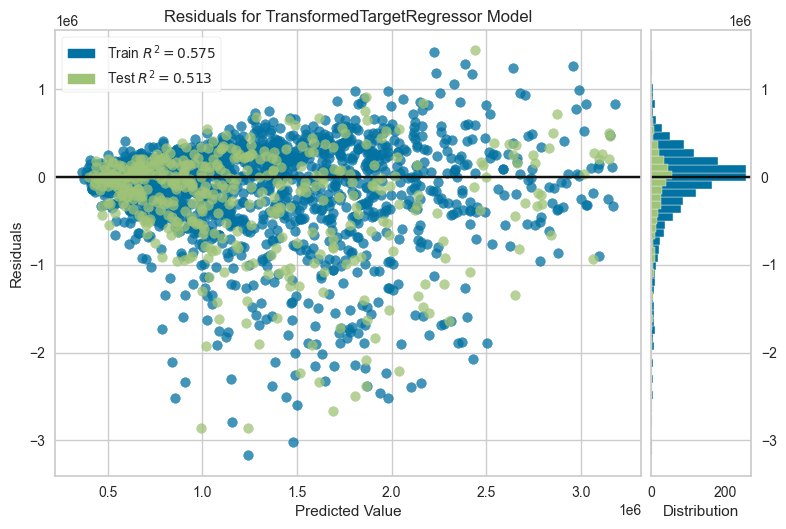

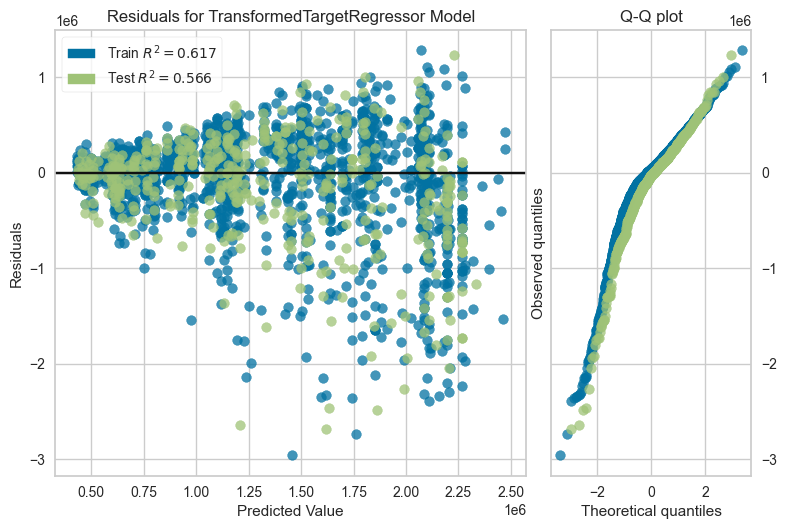

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [34]:
from sklearn.ensemble import AdaBoostRegressor

ada = AdaBoostRegressor(random_state=1, n_estimators=10000,learning_rate = 0.1)
# Combine the preparer and regressor into one pipeline
ada_pipline = make_pipeline(preparer, ada)

# This transforms the target variable before fitting the model,
# but gives out actual (back-transformed) prediction results automatically.
transformed_pipline = TransformedTargetRegressor(ada_pipline , func = np.log, inverse_func = np.exp)

mape_ada = -np.mean(cross_val_score(transformed_pipline, X, y, scoring = 'neg_mean_absolute_percentage_error'))
mae_ada = -np.mean(cross_val_score(transformed_pipline, X, y, scoring = 'neg_mean_absolute_error'))

print("Mean Absolute Percentage Error:", round(mape_ada ,2) *100)
print("Mean Absolute Error:", round(mae_ada))



transformed_pipeline.fit(X_train,y_train)
y_pred = transformed_pipeline.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipeline)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()

visualizer = ResidualsPlot(transformed_pipline, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()



It is a interesting case because while coefficient of determination is good, same as XGBOOST with 0.79, its MEAP is 27 which is 10% higher than the lowest MEPA we've seen so far. It means it still performs worse than we want.

# KNN Regression

KNN regression is a non-parametric method that, in an intuitive manner, approximates the association between independent variables and the continuous outcome by averaging the observations in the same neighbourhood.

Mean Absolute Percentage Error: 23.0
Mean Absolute Error: 317939
Mean squared error: 296949516402.26
Coefficient of determination: 0.64


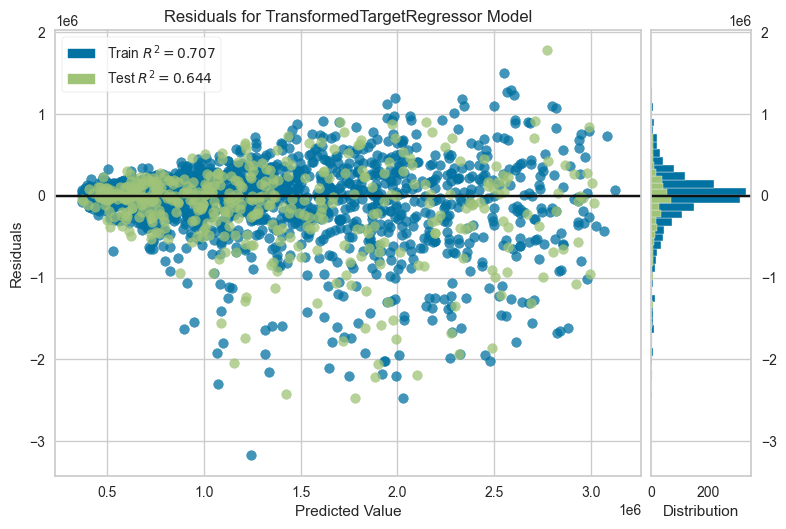

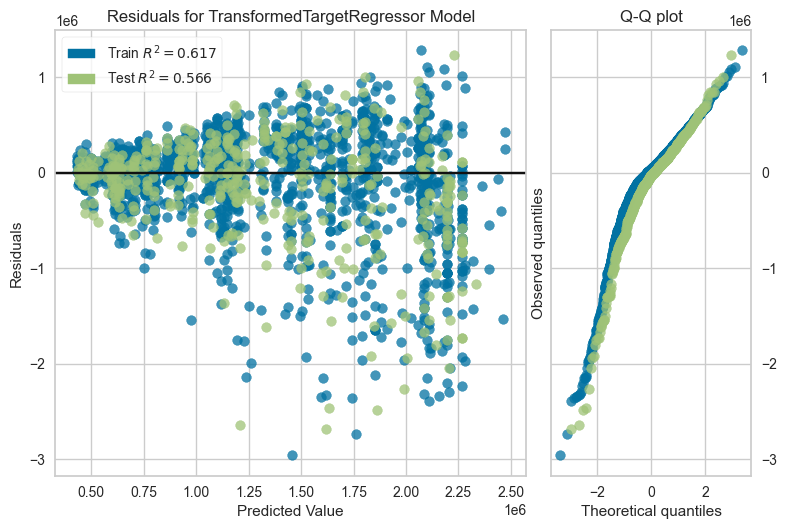

<AxesSubplot: title={'center': 'Residuals for TransformedTargetRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [35]:
from sklearn.neighbors import KNeighborsRegressor
knn = KNeighborsRegressor(n_neighbors=10)

knn_pipeline = make_pipeline(preparer, knn)

# This transforms the target variable before fitting the model,
# but gives out actual (back-transformed) prediction results automatically.
transformed_pipeline = TransformedTargetRegressor(knn_pipeline , func = np.log, inverse_func = np.exp)

mape_knn = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_percentage_error'))
mae_knn = -np.mean(cross_val_score(transformed_pipeline, X, y, scoring = 'neg_mean_absolute_error'))

print("Mean Absolute Percentage Error:", round(mape_knn ,2) *100)
print("Mean Absolute Error:", round(mae_knn))

transformed_pipeline.fit(X_train,y_train)
y_pred = transformed_pipeline.predict(X_test)


# The mean squared error
print("Mean squared error: %.2f" % mean_squared_error(y_test,y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))


visualizer = ResidualsPlot(transformed_pipeline)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()

visualizer = ResidualsPlot(transformed_pipline, hist=False, qqplot=True)
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()

Performs far worse than our best model.
It it the last algorithm that we will look at so now it is time to talk about the results we got.

### Results

I tried quite a few different models. Out of all them the best one happens to be XBOOST Regression with Mean Absolute Percentage Error of 17% and Mean Absolute Error of $238860. 

The pipline consists of Log Transformation + Standard Scalar to normalize the data and after that we use XGBOOSt to predict the price of the house.

83% accuracy is good, and it is better than I initially aimed for which was 80%. Table with more detailed results can be found in report accompanying this notebook file.

# Final Analysis

Project summary:

    1)Found the dataset on kaggle.
    2)Performed data cleaning.Dataset was not ideal to begin with because number of Bathrooms and Receptions were always equal to the number of Bedrooms for every house, which is not the case in real life therefore indicating that there was something wrong with the data.To fix it I got rid of "No. of Receptions" feature and randomly generated bathroom number for every house in a range from 1 to 2 that made it more realistic.
    3)Got rid of data samples with null values(962 samples in total).
    4)Looked at different statistics of the data to get better understanding of the dataset.(e.g highest and lowest priced house, most popular location, etc.)
    5)Got rid of few outliers.
    6)Visualized the dataset with various graphs and plots(e.g histograms,boxplots,etc.)
    7)Used Label Encoder to convert Categorical values to numerical.
    8)Looked at correlations between different features.(Price has highest correlation with Area and with Number of Rooms.
    9)Added new feature called "Total No. of Rooms" which is bedrooms + bathroom number.
    10)Chose Mean Absolute Percentage Error and Mean Absolute Error for performance metrics.
    11)Built different ML models and comapred their performance.
    12)Out of Linear Regression,Lasso Regression,Ridge Regression,Gradient Boosting Regression,Elastic Net,Bagging Regression,Support Vector Machine,XGBOOST,AdaBoost, and KNN the model that performed the best is XGBOOST with MAPE of 17% and MAE of $238860. 

    In the end having 83% accuracy is good but I think to improve it and have lower MAE I need more data(2518 data points is not enough).In addition I think the number of features were not enough as well, first of all, there was an issue with 2 features(No.of Bathrooms and No. of Receptions) which were exactly the same for every data point and I had to randomly generate them which did not help and even maybe made it worse. Secondly, much of the categorical features such as Location, Postal Code, City/County are basically different name for the same feature. Each of them identify the location of the house so I don't think they added much value at all.With more features and more data I believe my model would perform much better and maybe get to 90% accuracy which would be a success. In Conclusion, it is definitely possible to predict a house price with relatively good accuracy and low margin of error; the best algorithms to use from what I have observed are ensemble models that aim at improving the accuracy of results in models by combining multiple models instead of using a single model. The one thing I regret is that I did not use Neural Nets properly. I tried a simple architecture but it was performing really bad and I decided not to included it at all. I did not have enough time to come up with more complex one and try fine-tuning and testing it.I want to do it on my own, outside of this project scope. I will upload the results if I see any performance improvements. Overall, I believe that the project can be considered successful even though, for sure there is a room for improvement.


In [37]:
from joblib import dump
dump(transformed_pipeline_xgbr, 'pipeline.joblib') # saving the model

['pipeline.joblib']